In [25]:
from pymodulon.io import *
from pymodulon.plotting import *
from os import path
import altair as alt

In [2]:
data_dir = path.join('..','data','5g_processed_data')
#interim_dir = path.join('..','data','5g_interim')

In [3]:
#ica_data = load_json_model(path.join(data_dir,'5g_raw.json.gz'))
ica_data = load_json_model(path.join(data_dir,'5g_raw_lowExAdj.json.gz'))

In [4]:
#DF_enrichments = pd.read_csv(path.join(data_dir,'5G_functional_enrichments.csv'),index_col=0)
DF_enrichments = pd.read_csv(path.join(data_dir,'5G_functional_enrichments_lowExAdj.csv'),index_col=0)

In [12]:
ica_data.X.shape

(4213, 86)

# Add iModulon category

In [5]:
for i,row in ica_data.imodulon_table.iterrows():
    # if pd.notnull(row.regulator):
    #     ica_data.imodulon_table.loc[i, 'category'] = 'regulatory'
    if pd.notnull(row.single_gene):
        ica_data.imodulon_table.loc[i, 'category'] = 'single_gene'
    else:
        ica_data.imodulon_table.loc[i, 'category'] = 'uncharacterized'

In [6]:
ica_data.imodulon_table.head(15)

,single_gene,imodulon_size,explained_variance,category
0,NaN,194,0.014615,uncharacterized
1,NaN,78,0.018475,uncharacterized
SG_1,True,1,0.003957,single_gene
3,NaN,9,0.004476,uncharacterized
SG_2,True,1,0.005372,single_gene
5,NaN,3,0.007145,uncharacterized
6,NaN,18,0.012815,uncharacterized
SG_3,True,1,0.004262,single_gene
8,NaN,49,0.019220,uncharacterized
9,NaN,342,0.014302,uncharacterized


# Inspect all iModulons without an automated annotation

In [7]:
unchar_imods = ica_data.imodulon_table[ica_data.imodulon_table.category == 'uncharacterized']

In [8]:
unchar_imods

,single_gene,imodulon_size,explained_variance,category
0,NaN,194,0.014615,uncharacterized
1,NaN,78,0.018475,uncharacterized
3,NaN,9,0.004476,uncharacterized
5,NaN,3,0.007145,uncharacterized
6,NaN,18,0.012815,uncharacterized
8,NaN,49,0.019220,uncharacterized
9,NaN,342,0.014302,uncharacterized
10,NaN,154,0.024830,uncharacterized
11,NaN,61,0.040583,uncharacterized
12,NaN,11,0.005806,uncharacterized


### iModulon 0: Unknown

In [9]:
ica_data.view_imodulon(0)

,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00185,-0.043629,NaN,42145,42478,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIJ4,2806,EQU24_RS00185,WP_017841440.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00190,0.044572,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00625,0.053743,NaN,129668,131204,1,NaN,X,No COG annotation,NaN,2744,EQU24_RS00625,NaN,||,NaN,[]
EQU24_RS00630,0.053743,NaN,131271,131348,1,NaN,X,No COG annotation,NaN,2743,EQU24_RS00635 // EQU24_RS00630,NaN,||,NaN,[]
EQU24_RS00635,0.053743,NaN,131419,131495,1,NaN,X,No COG annotation,NaN,2743,EQU24_RS00635 // EQU24_RS00630,NaN,||,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21615,0.053743,NaN,4878614,4879973,-1,hypothetical protein,X,No COG annotation,A0A4P9USM4,71,EQU24_RS21615,WP_017841574.1,||None,NaN,[]
EQU24_RS21620,0.053743,tkt,4880130,4882143,-1,transketolase,H,Coenzyme transport and metabolism,A0A4P9UVR0,70,tkt,WP_017841573.1,tkt||tkt,positive regulation of nucleic acid-templated ...,['positive regulation of nucleic acid-template...
EQU24_RS21710,0.034641,NaN,4898362,4898659,1,hypothetical protein,X,No COG annotation,A0A4P9USP2,53,EQU24_RS21710,WP_017841559.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS21805,0.048207,NaN,4919710,4919809,1,hypothetical protein,X,No COG annotation,NaN,44,EQU24_RS21810 // EQU24_RS21805,NaN,||,NaN,[]


<AxesSubplot:ylabel='0 iModulon\nActivity'>

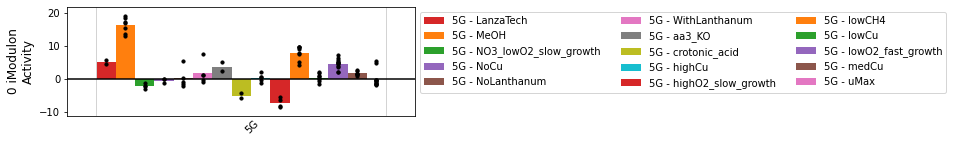

In [18]:
plot_activities(ica_data,0,highlight=['5G'])

# Erin's replotting attempt

In [13]:
def plot_activities_erin(
    ica_data, imodulon, assigned_colors=None, ax=None, legend_kwargs=None
):
    """
    Creates a barplot showing an iModulon's activity across the compendium
    Parameters
    ----------
    ica_data: ~pymodulon.core.IcaData
        :class:`~pymodulon.core.IcaData` object
    imodulon: int or str
        `iModulon` name
    projects: list or str, optional
        Name(s) of `projects` to show (default: show all)
    highlight: str or list, optional
        Name(s) of projects to `highlight` (default: None)
    ax: ~matplotlib.axes.Axes, optional
        Axes object to plot on, otherwise use current Axes
    legend_kwargs: dict, optional
        Additional keyword arguments passed to :func:`matplotlib.pyplot.legend`
    Returns
    -------
    ax: ~matplotlib.axes.Axes
        :class:`~matplotlib.axes.Axes` containing the barplot
    """

    # Check that iModulon exists
    if imodulon in ica_data.A.index:
        values = ica_data.A.loc[imodulon]
    else:
        raise ValueError(f"iModulon does not exist: {imodulon}")

    label = "{} iModulon\nActivity".format(imodulon)

    return barplot_erin(
        values=values,
        sample_table=ica_data.sample_table,
        ylabel=label,
        # projects=projects,
        # highlight=highlight,
        assigned_colors=assigned_colors,
        ax=ax,
        legend_kwargs=legend_kwargs,
    )


In [14]:
def barplot_erin(
    values,
    sample_table,
    ylabel="",
    #projects=None,
    #highlight=None,
    assigned_colors=None,
    ax=None,
    legend_kwargs=None,
):
    """
    Creates an overlaid scatter and barplot for a set of values (either gene
    expression levels or iModulon activities)
    Parameters
    ----------
    values: ~pandas.Series
        List of `values` to plot
    sample_table: ~pandas.DataFrame
        Sample table from :class:`~pymodulon.core.IcaData` object
    ylabel: str, optional
        Y-axis label
    projects: list or str, optional
        Name(s) of `projects` to show (default: show all)
    highlight: list or str, optional
        Project(s) to `highlight` (default: None)
    ax: ~matplotlib.axes.Axes, optional
        Axes object to plot on, otherwise use current Axes
    legend_kwargs: dict, optional
        Additional keyword arguments passed to :func:`matplotlib.pyplot.legend`
    Returns
    -------
    ax: ~matplotlib.axes.Axes
        :class:`~matplotlib.axes.Axes` containing the barplot
    """

    # # Remove extra projects
    # if isinstance(projects, str):
    #     projects = [projects]

    # if projects is not None and len(projects) == 1:
    #     highlight = projects

    # if projects is not None and "project" in sample_table:
    #     sample_table = sample_table[sample_table.project.isin(projects)]
    #     values = values[sample_table.index]

    if ax is None:
        figsize = (len(values) / 15 + 0.5, 2)
        fig, ax = plt.subplots(figsize=figsize)

    # Get ymin and max
    ymin = values.min()
    ymax = values.max()
    yrange = ymax - ymin
    ymax = max(1, max(ymax * 1.1, ymax + yrange * 0.1))
    ymin = min(-1, min(ymin * 1.1, ymin - yrange * 0.1))
    yrange = ymax - ymin

    # Add project-specific information
    if "project" in sample_table.columns and "condition" in sample_table.columns:

        # Sort data by project/condition to ensure replicates are together
        metadata = sample_table.loc[:, ["project", "condition"]]
        metadata = metadata.sort_values(["project", "condition"])
        #metadata["name"] = metadata.project + " - " + metadata.condition.astype(str)
        metadata["name"] = metadata.condition.astype(str)

        # set xaxis order
        xorder = ['uMax','MeOH','NoCu','lowCu','medCu','highCu','lowCH4','WithLanthanum','NoLanthanum','highO2_slow_growth','NO3_lowO2_slow_growth','lowO2_fast_growth',]
        metadata['xorder'] = pd.Categorical(metadata['condition'],categories=xorder)
        metadata = metadata.sort_values('xorder')

        # Coerce highlight to iterable
        # if highlight is None:
        #     highlight = []
        # elif isinstance(highlight, str):
        #     highlight = [highlight]

        # Get X and Y values for scatter points
        metadata["y"] = values
        metadata["x"] = np.cumsum(~metadata[["name"]].duplicated())
        # ^^ looks for name duplications, increments when finds non-duplicated name

        # Get heights for barplot
        bar_vals = metadata.groupby("x").mean()

        # Add colors and names
        bar_vals["name"] = metadata.drop_duplicates("name").name.values
        bar_vals["project"] = metadata.drop_duplicates("name").project.values
        #bar_vals['xorder'] = pd.Categorical(bar_vals['name'],categories=xorder)
        #bar_vals = bar_vals.sort_values('xorder').reset_index()
        #return bar_vals


        # Plot bars for highlighted samples
        #color_vals = bar_vals[bar_vals.project.isin(highlight)]
        color_cycle = [
            "tab:red",
            "tab:orange",
            "tab:green",
            "tab:purple",
            "tab:brown",
            "tab:pink",
            "tab:gray",
            "tab:olive",
            "tab:cyan",
        ]


        i = 0
        #for name, group in bar_vals.groupby("name"):
        for j,row in bar_vals.iterrows():
            cond = row['name']
            if cond in assigned_colors:
                c = assigned_colors[cond]
            else:
                c = color_cycle[i]
                i = (i + 1) % len(color_cycle)
            ax.bar(
                #row.index,
                j,
                row.y,
                color=c,
                width=1,
                linewidth=0,
                align="edge",
                zorder=1,
                label=cond,
            )
            

        # # Plot bars for non-highlighted samples
        # other_vals = bar_vals[~bar_vals.project.isin(highlight)]
        # ax.bar(
        #     other_vals.index,
        #     other_vals.y,
        #     color="tab:blue",
        #     width=1,
        #     linewidth=0,
        #     align="edge",
        #     zorder=1,
        #     label=None,
        # )
        ax.scatter(metadata.x + 0.5, metadata.y, color="k", zorder=2, s=10)

        # Get project names and sizes
        projects = metadata.project.drop_duplicates()
        md_cond = metadata.drop_duplicates(["name"])
        project_sizes = [len(md_cond[md_cond.project == proj]) for proj in projects]
        nbars = len(md_cond)

        # Draw lines to discriminate between projects
        proj_lines = np.cumsum([1] + project_sizes)
        ax.vlines(proj_lines, ymin, ymax, colors="lightgray", linewidth=1)

        # # Add project names
        # texts = []
        # start = 2
        # for proj, size in zip(projects, project_sizes):
        #     x = start + size / 2
        #     texts.append(
        #         ax.text(
        #             x, ymin - yrange * 0.02, proj, ha="right", va="top", rotation=45
        #         )
        #     )
        #     start += size

        # Add cond names
        texts = []
        start = 1
        size=1
        for pos,cond in enumerate(bar_vals['name'].values):
            x = start + size / 2
            #x=x+2
            texts.append(
                ax.text(
                    x, ymin - yrange * 0.02, cond, ha="center", va="top", rotation=90
                )
            )
            start += size

        # Add legend
        #if not color_vals.empty:
        if not bar_vals.empty:
            kwargs = {
                "bbox_to_anchor": (1, 1),
                "ncol": len(bar_vals.name.unique()) // 8+1#6 + 1,
            }

            if legend_kwargs is not None:
                kwargs.update(legend_kwargs)

            ax.legend(**kwargs)

    else:
        logging.warning("Missing `project` and `condition` columns in `sample_table.`")
        ax.bar(range(len(values)), values, width=1, align="edge")
        nbars = len(values)

    # Set axis limits
    xmin = -0.5
    xmax = nbars + 2.5
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    # Axis labels
    ax.set_ylabel(ylabel, fontsize=12)
    ax.set_xticks([])

    # X-axis
    ax.hlines(0, xmin, xmax, color="k")

    return ax

In [15]:
# specific colors to use for plots
color_spec = {
    'uMax':'#d9d9d9', # gray
    'NoCu':'#bdd7e7', # blues
    'lowCu':'#6baed6', # blues
    'medCu':'#3182bd', # blues
    'highCu':'#08519c', # blues
    'lowCH4':'#b3de69', # green
    'WithLanthanum':'#e6550d', #orange
    'NoLanthanum':'#fdbe85', #orange
    'MeOH':'#fb8072', #red
    'highO2_slow_growth':'#6a3d9a',
    'NO3_lowO2_slow_growth':'#bc80bd', # purple
    'lowO2_fast_growth':'#fccde5', # pink
    'LanzaTech':'#33a02c', #green
    'aa3_KO':'#e6f598', # light green
    'crotonic_acid':'#fee08b', #yellow
}

In [16]:
def imod_scatter(ica_data, mod_id):
    mod_row = ica_data.imodulon_table[ica_data.imodulon_table.index==mod_id]
    size = mod_row['imodulon_size'].values[0]
    fig = plt.figure(figsize=(3,3))
    sns.scatterplot(data=ica_data.imodulon_table, x='imodulon_size',y='explained_variance')
    sns.scatterplot(data=mod_row, x='imodulon_size',y='explained_variance',color='r',s=200)
    plt.title(f'iModulon {mod_id} ({size} genes)')
    plt.show()

In [27]:
def view_imod_weights_on_genome(ica_data, imod_id):
    genes_in_imod = set(ica_data.view_imodulon(imod_id).index)
    gene2weight = dict(ica_data.M[imod_id].reset_index().values)
    temp_df = ica_data.gene_table[['gene_symbol','product','start_coord']].fillna('')
    temp_df.index.name='locus_tag'
    temp_df = temp_df.reset_index()
    temp_df['weight'] = temp_df['locus_tag'].apply(lambda x: gene2weight[x])
    temp_df['in_imod?'] = temp_df['locus_tag'].apply(lambda x: x in genes_in_imod)
    
    

    chart = alt.Chart(temp_df).mark_circle(size=60).encode(
        x=alt.X('start_coord:Q',axis=alt.Axis(title='Genomic Coordinate')),
        y=alt.Y('weight:Q',axis=alt.Axis(title=f'M weight for iModulon {imod_id}')),
        color='in_imod?:N',
        tooltip=['locus_tag:N', 'gene_symbol:N', 'product:N','in_imod?:N']
    ).interactive()
    display(chart)

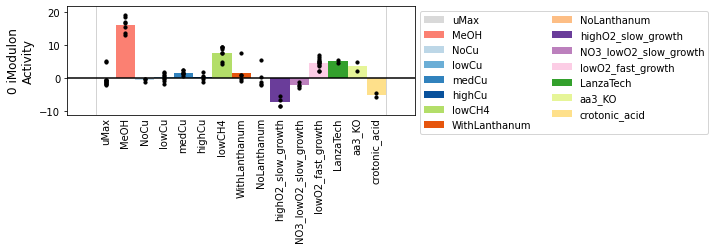

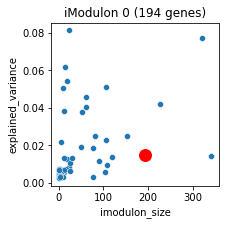

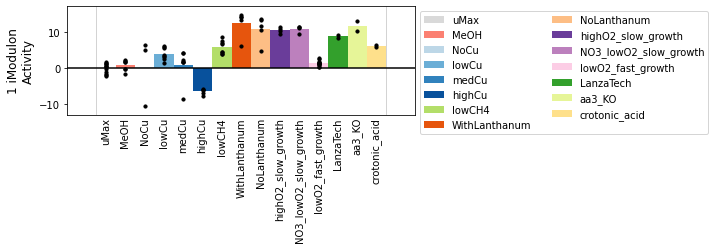

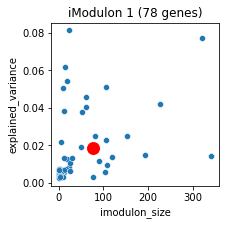

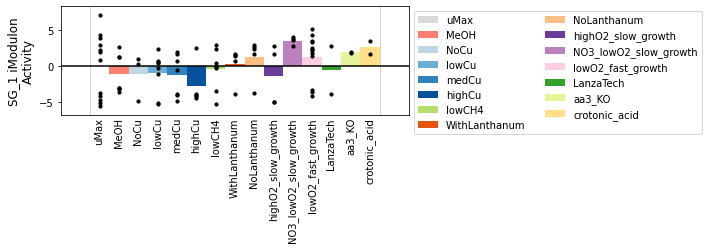

...

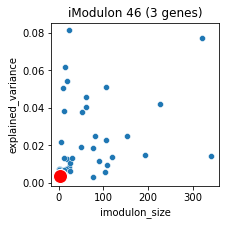

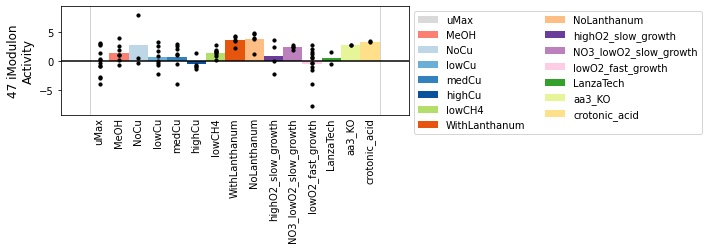

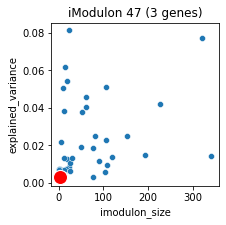

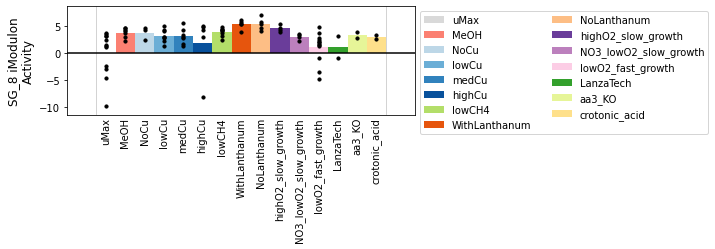

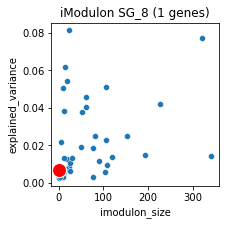

In [17]:
for mod in ica_data.imodulon_table.index:
    plot_activities_erin(ica_data,mod,assigned_colors=color_spec)
    imod_scatter(ica_data,mod)
    #ica_data.view_imodulon(mod)

# Look one at a time

In [23]:
def imod_info(mod):
    print(f"iModulon {mod}")
    plot_activities_erin(ica_data,mod,assigned_colors=color_spec)
    imod_scatter(ica_data,mod)
    view_imod_weights_on_genome(ica_data,mod)
    display(DF_enrichments[DF_enrichments.imodulon==mod].sort_values('f1score',ascending=False))
    display(ica_data.view_imodulon(mod))

## iMod 0

iModulon 0


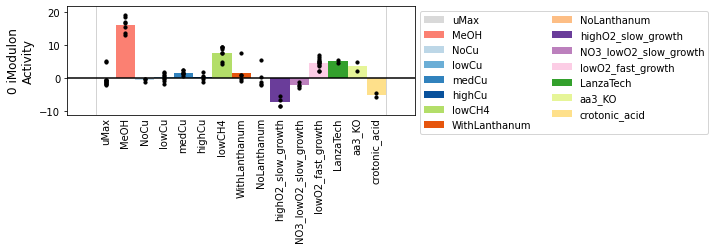

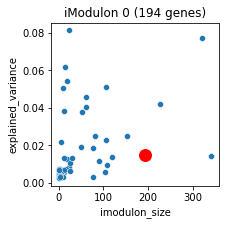

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
0,0,transposase activity,2.420907e-09,0.000009,0.082474,0.280702,0.127490,16.0,57.0,194.0,GO,NaN,NaN,NaN
1,0,"transposition, DNA-mediated",4.227279e-09,0.000009,0.082474,0.271186,0.126482,16.0,59.0,194.0,GO,NaN,NaN,NaN
2,0,RNA-directed DNA polymerase activity,2.291670e-07,0.000235,0.030928,0.750000,0.059406,6.0,8.0,194.0,GO,NaN,NaN,NaN
3,0,RNA-templated DNA biosynthetic process,2.291670e-07,0.000235,0.030928,0.750000,0.059406,6.0,8.0,194.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00185,-0.043629,NaN,42145,42478,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIJ4,2806,EQU24_RS00185,WP_017841440.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00190,0.044572,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00625,0.053743,NaN,129668,131204,1,NaN,X,No COG annotation,NaN,2744,EQU24_RS00625,NaN,||,NaN,[]
EQU24_RS00630,0.053743,NaN,131271,131348,1,NaN,X,No COG annotation,NaN,2743,EQU24_RS00635 // EQU24_RS00630,NaN,||,NaN,[]
EQU24_RS00635,0.053743,NaN,131419,131495,1,NaN,X,No COG annotation,NaN,2743,EQU24_RS00635 // EQU24_RS00630,NaN,||,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21615,0.053743,NaN,4878614,4879973,-1,hypothetical protein,X,No COG annotation,A0A4P9USM4,71,EQU24_RS21615,WP_017841574.1,||None,NaN,[]
EQU24_RS21620,0.053743,tkt,4880130,4882143,-1,transketolase,H,Coenzyme transport and metabolism,A0A4P9UVR0,70,tkt,WP_017841573.1,tkt||tkt,positive regulation of nucleic acid-templated ...,['positive regulation of nucleic acid-template...
EQU24_RS21710,0.034641,NaN,4898362,4898659,1,hypothetical protein,X,No COG annotation,A0A4P9USP2,53,EQU24_RS21710,WP_017841559.1,||None,integral component of membrane,['integral component of membrane']


In [28]:
imod = 0 
imod_info(imod)

In [19]:
# Update the ica_data object
#ica_data.rename_imodulons({0:'0-uncharacterized_EW'})
#ica_data.imodulon_table.loc[0,'category'] = 'uncharacterized'

# seems like a mix of a lot of things... expression pattern not clear...

In [29]:
ica_data.imodulon_table.loc[0,'function'] = 'large-transposase_EW'
ica_data.imodulon_table.head()

,single_gene,imodulon_size,explained_variance,category,function
0,NaN,194,0.014615,uncharacterized,large-transposase_EW
1,NaN,78,0.018475,uncharacterized,NaN
SG_1,True,1,0.003957,single_gene,NaN
3,NaN,9,0.004476,uncharacterized,NaN
SG_2,True,1,0.005372,single_gene,NaN


## iMod 1

iModulon 1


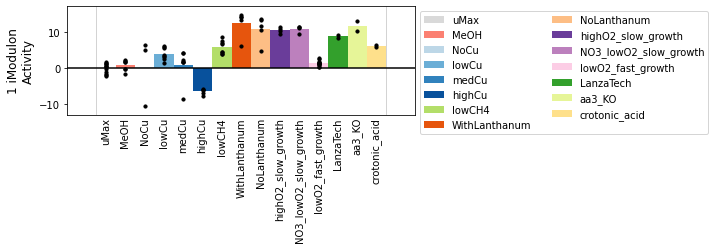

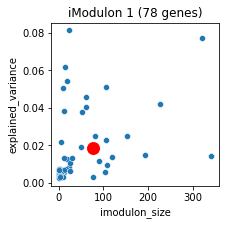

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
4,1,bacterial-type flagellum-dependent cell motility,3.959071e-11,1.624407e-07,0.128205,0.344828,0.186916,10.0,29.0,78.0,GO,NaN,NaN,NaN
0,1,NaN,3.374192e-10,8.536705e-08,0.141026,0.239130,0.177419,11.0,46.0,78.0,KEGG pathways,map02040,Flagellar assembly,NaN
9,1,transposase activity,7.629748e-06,5.217476e-03,0.102564,0.140351,0.118519,8.0,57.0,78.0,GO,NaN,NaN,NaN
10,1,"transposition, DNA-mediated",9.937890e-06,5.825023e-03,0.102564,0.135593,0.116788,8.0,59.0,78.0,GO,NaN,NaN,NaN
6,1,sulfate transmembrane transport,4.482900e-07,6.131112e-04,0.064103,0.500000,0.113636,5.0,10.0,78.0,GO,NaN,NaN,NaN
8,1,cell projection,4.967546e-06,5.012627e-03,0.064103,0.333333,0.107527,5.0,15.0,78.0,GO,NaN,NaN,NaN
5,1,ABC-type sulfate transporter activity,1.088211e-07,2.232464e-04,0.051282,1.000000,0.097561,4.0,4.0,78.0,GO,NaN,NaN,NaN
0,1,NaN,1.088211e-07,3.699917e-05,0.051282,1.000000,0.097561,4.0,4.0,78.0,KEGG modules,M00185,NaN,NaN
13,1,bacterial-type flagellum,2.155327e-04,8.843307e-02,0.051282,0.235294,0.084211,4.0,17.0,78.0,GO,NaN,NaN,NaN
7,1,"bacterial-type flagellum basal body, rod",6.108490e-06,5.012627e-03,0.038462,1.000000,0.074074,3.0,3.0,78.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00075,-0.048790,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00185,0.060228,NaN,42145,42478,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIJ4,2806,EQU24_RS00185,WP_017841440.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00190,0.052273,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00250,-0.049736,NaN,50778,51069,1,hypothetical protein,X,No COG annotation,A0A4P9UIB5,2796,EQU24_RS00250,WP_017841431.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS01135,0.087281,NaN,231558,231840,1,hypothetical protein,X,No COG annotation,A0A4P9ULJ3,2673,EQU24_RS01140 // EQU24_RS01135 // EQU24_RS0113...,WP_017841271.1,||None,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS20950,0.154909,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]
EQU24_RS21260,-0.125299,NaN,4791094,4791280,1,hypothetical protein,X,No COG annotation,NaN,120,EQU24_RS21260,NaN,||,NaN,[]
EQU24_RS21445,0.060259,NaN,4828409,4828703,1,STAS domain-containing protein,T,Signal transduction mechanisms,A0A4P9USJ5,91,EQU24_RS21450 // EQU24_RS21445,WP_017841598.1,||None,NaN,[]


In [30]:
imod_info(1)

In [31]:
# Update the ICA data object
#ica_data.rename_imodulons({1:'1-uncharacterized_EW'})
ica_data.imodulon_table.loc[1,'function'] = 'transposase-sulfate-flagella?_EW'
ica_data.imodulon_table.head()


,single_gene,imodulon_size,explained_variance,category,function
0,NaN,194,0.014615,uncharacterized,large-transposase_EW
1,NaN,78,0.018475,uncharacterized,transposase-sulfate-flagella?_EW
SG_1,True,1,0.003957,single_gene,NaN
3,NaN,9,0.004476,uncharacterized,NaN
SG_2,True,1,0.005372,single_gene,NaN


## iMod 2

iModulon SG_1


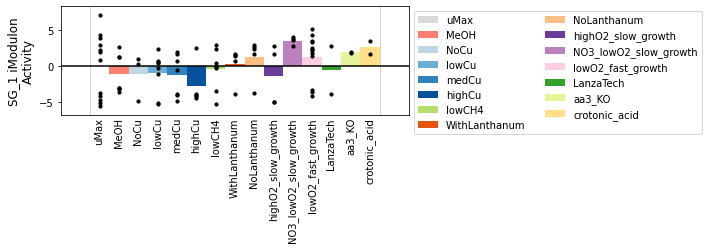

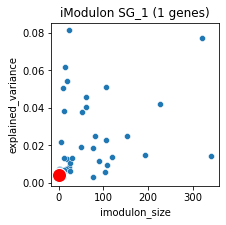

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS11910,0.754069,NaN,2663997,2664351,1,hypothetical protein,X,No COG annotation,NaN,1330,EQU24_RS11910,NaN,||,NaN,[]


In [33]:
imod_info("SG_1")

In [34]:
ica_data.imodulon_table.loc["SG_1",'function'] = 'sg-hypothetical-prot_EW'



In [35]:
ica_data.imodulon_table.head()

,single_gene,imodulon_size,explained_variance,category,function
0,NaN,194,0.014615,uncharacterized,large-transposase_EW
1,NaN,78,0.018475,uncharacterized,transposase-sulfate-flagella?_EW
SG_1,True,1,0.003957,single_gene,sg-hypothetical-prot_EW
3,NaN,9,0.004476,uncharacterized,NaN
SG_2,True,1,0.005372,single_gene,NaN


### iModulon 3


iModulon 3


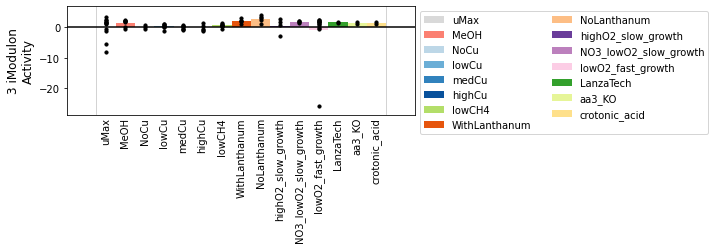

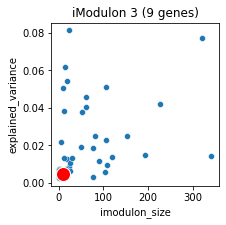

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS01175,0.219977,umuD,237101,237485,-1,translesion error-prone DNA polymerase V autop...,K,Transcription,UPI00191C1247,2668,umuD // EQU24_RS01170,WP_201764864.1,umuD||umuD,"regulation of transcription, DNA-templated\nDN...","['regulation of transcription, DNA-templated' ..."
EQU24_RS01555,0.229448,NaN,328948,329197,1,hypothetical protein,X,No COG annotation,NaN,2616,EQU24_RS01555,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS03435,0.246210,NaN,731708,731891,-1,hypothetical protein,X,No COG annotation,NaN,2379,EQU24_RS03435,NaN,||,NaN,[]
EQU24_RS03455,0.252396,NaN,734828,735008,-1,hypothetical protein,X,No COG annotation,NaN,2375,EQU24_RS03455,NaN,||,NaN,[]
EQU24_RS08710,0.167636,NaN,1931194,1931374,1,hypothetical protein,X,No COG annotation,NaN,1728,EQU24_RS08720 // EQU24_RS08715 // EQU24_RS08710,NaN,||,NaN,[]
EQU24_RS10685,0.266299,NaN,2375624,2376014,-1,hypothetical protein,X,No COG annotation,A0A4P9UQ25,1488,EQU24_RS10685 // EQU24_RS10680,WP_040575281.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS11990,0.203149,NaN,2680903,2681857,-1,IS1595 family transposase,L,"Replication, recombination and repair",A0A4P9UQQ5,1320,EQU24_RS11990 // EQU24_RS11985,WP_017839276.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS16380,0.286783,NaN,3678261,3678483,-1,hypothetical protein,X,No COG annotation,A0A4P9UQD6,753,EQU24_RS16380,WP_017842548.1,||None,NaN,[]
EQU24_RS21260,0.211530,NaN,4791094,4791280,1,hypothetical protein,X,No COG annotation,NaN,120,EQU24_RS21260,NaN,||,NaN,[]


In [36]:
#imod_info(3)
imod_info(3)

In [37]:
ica_data.imodulon_table.loc[3,'function'] = 'transposase/FM11_TR1_QC-outlier-response_EW'
ica_data.imodulon_table.head()


,single_gene,imodulon_size,explained_variance,category,function
0,NaN,194,0.014615,uncharacterized,large-transposase_EW
1,NaN,78,0.018475,uncharacterized,transposase-sulfate-flagella?_EW
SG_1,True,1,0.003957,single_gene,sg-hypothetical-prot_EW
3,NaN,9,0.004476,uncharacterized,transposase/FM11_TR1_QC-outlier-response_EW
SG_2,True,1,0.005372,single_gene,NaN


## iMod 4

iModulon SG_2


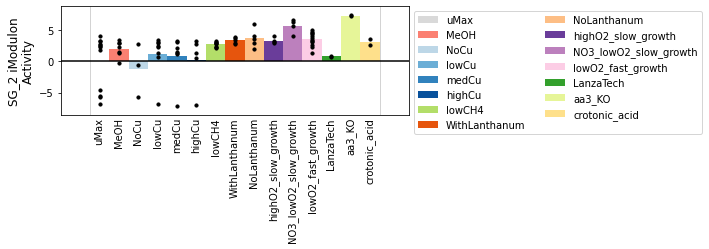

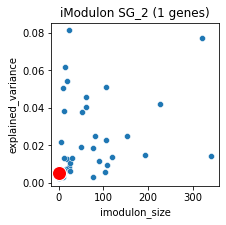

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS17330,0.704988,NaN,3884125,3884449,-1,(2Fe-2S) ferredoxin domain-containing protein,C,Energy production and conversion,A0A4P9UTU3,638,EQU24_RS17330 // EQU24_RS17325 // EQU24_RS1732...,WP_017842361.1,||None,NaN,[]


In [39]:
imod_info("SG_2")

In [40]:
ica_data.imodulon_table.loc["SG_2",'function'] = 'sg-ferrdoxin_domain_EW'


## iMod 5

iModulon 5


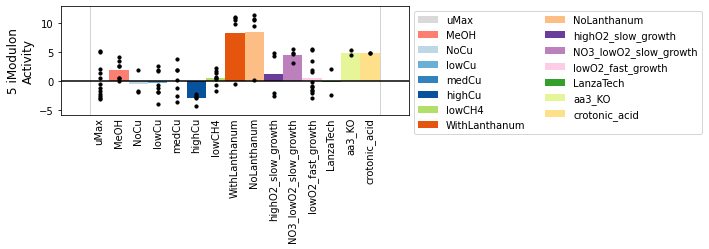

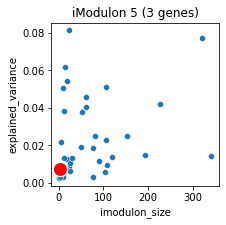

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS09050,0.215265,NaN,2000662,2002213,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,1685,EQU24_RS09050,WP_040575330.1,||None,NaN,[]
EQU24_RS16560,0.541969,NaN,3715697,3717248,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,727,EQU24_RS16560,WP_040575330.1,||None,NaN,[]
EQU24_RS20950,0.289217,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]


In [41]:
imod_info(5)

In [42]:
ica_data.imodulon_table.loc[5,'function'] = 'small-transposase_EW'


## iMod 6

iModulon 6


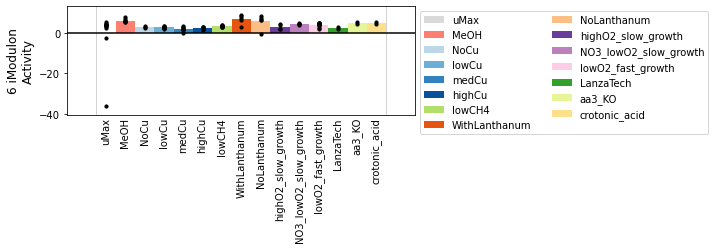

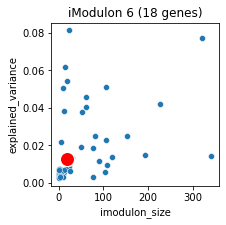

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
14,6,transposase activity,0.000003,0.006935,0.277778,0.087719,0.133333,5.0,57.0,18.0,GO,NaN,NaN,NaN
15,6,"transposition, DNA-mediated",0.000003,0.006935,0.277778,0.084746,0.129870,5.0,59.0,18.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00145,0.211805,NaN,34142,34445,-1,hypothetical protein,J,"Translation, ribosomal structure and biogenesis",A0A4P9UL47,2812,EQU24_RS00155 // EQU24_RS00150 // EQU24_RS00145,WP_014146553.1,||None,response to osmotic stress\nresponse to abioti...,['response to osmotic stress' 'response to abi...
EQU24_RS00250,0.236866,NaN,50778,51069,1,hypothetical protein,X,No COG annotation,A0A4P9UIB5,2796,EQU24_RS00250,WP_017841431.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS04120,0.168209,NaN,864711,865458,1,AAA family ATPase,L,"Replication, recombination and repair",A0A4P9UK85,2313,EQU24_RS04120 // EQU24_RS04115,WP_017840713.1,||istB,ATP binding,['ATP binding']
EQU24_RS06205,0.168999,NaN,1352804,1353026,-1,hypothetical protein,X,No COG annotation,NaN,2050,EQU24_RS06205,NaN,||,phosphorelay signal transduction system\ninteg...,['phosphorelay signal transduction system'\n '...
EQU24_RS08030,0.157936,NaN,1772272,1773559,-1,IS4 family transposase,L,"Replication, recombination and repair",NaN,1821,EQU24_RS08030,WP_244310909.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS08840,0.204699,NaN,1960369,1961011,-1,transposase,X,No COG annotation,UPI00110D0B97,1711,EQU24_RS08840,WP_138767140.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS08855,0.134101,NaN,1962417,1963410,1,hypothetical protein,S,Function unknown,A0A4P9UM20,1709,EQU24_RS08855,WP_017839829.1,||None,NaN,[]
EQU24_RS09155,0.153334,NaN,2027636,2027831,-1,hypothetical protein,X,No COG annotation,NaN,1672,EQU24_RS09155,NaN,||,NaN,[]
EQU24_RS10680,0.143153,NaN,2374756,2375617,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI0015862106,1488,EQU24_RS10685 // EQU24_RS10680,WP_175421679.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [43]:
imod_info(6)

In [44]:
ica_data.imodulon_table.loc[6,'function'] = 'transposase/FM03_TR1_QC-outlier-response_EW'


## iMod 7

iModulon SG_3


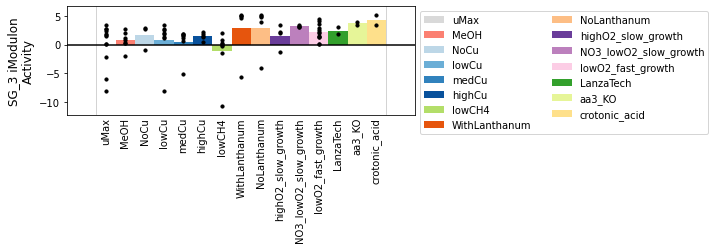

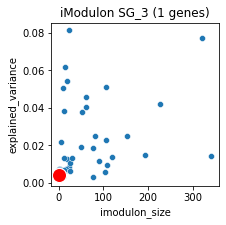

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS20580,0.576899,NaN,4639230,4639488,-1,hypothetical protein,X,No COG annotation,UPI00191C2B5C,217,EQU24_RS20585 // EQU24_RS20580,WP_201764870.1,||None,NaN,[]


In [46]:
imod_info("SG_3")

In [47]:
ica_data.imodulon_table.loc["SG_3",'function'] = 'sg-hypothetical_EW'


## iMod 8

iModulon 8


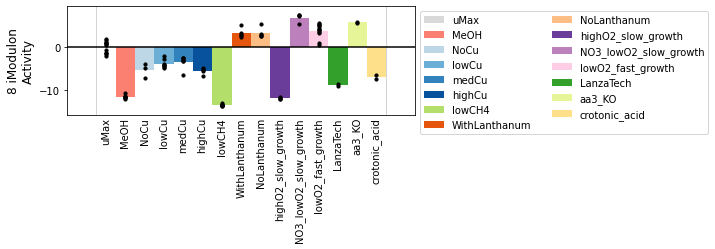

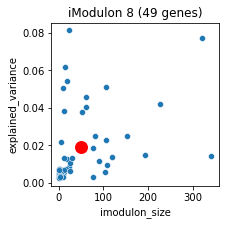

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
16,8,metallo-sulfur cluster assembly,0.000015,0.059707,0.061224,0.6,0.111111,3.0,5.0,49.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00305,0.110626,NaN,67787,68192,1,response regulator,T,Signal transduction mechanisms,A0A4P9UIC2,2787,EQU24_RS00310 // EQU24_RS00305 // EQU24_RS00300,WP_014146573.1,||None,phosphorelay signal transduction system,['phosphorelay signal transduction system']
EQU24_RS00310,0.080930,NaN,68188,70348,1,GGDEF domain-containing response regulator,T,Signal transduction mechanisms,A0A4P9UK63,2787,EQU24_RS00310 // EQU24_RS00305 // EQU24_RS00300,WP_017841419.1,||None,"regulation of transcription, DNA-templated\nph...","['regulation of transcription, DNA-templated'\..."
EQU24_RS01305,-0.098893,NaN,265994,267545,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2653,EQU24_RS01305,WP_244310896.1,||None,NaN,[]
EQU24_RS01370,-0.055929,NaN,286272,286348,-1,NaN,X,No COG annotation,NaN,2644,EQU24_RS01370,NaN,||,NaN,[]
EQU24_RS02975,0.057871,NaN,635255,635465,1,hypothetical protein,X,No COG annotation,A0A4V1IJG5,2428,EQU24_RS02975,WP_014147102.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS03035,0.109024,yidD,652568,652808,1,membrane protein insertion efficiency factor YidD,S,Function unknown,NaN,2417,yidD,WP_175421656.1,yidD||yidD,plasma membrane,['plasma membrane']
EQU24_RS03040,0.202019,NaN,653037,653427,-1,hypothetical protein,X,No COG annotation,A0A4P9UJY8,2416,EQU24_RS03040,WP_017840915.1,||None,NaN,[]
EQU24_RS04025,-0.057914,sodB,845349,845931,1,superoxide dismutase [Fe],C,Energy production and conversion,A0A4P9UJW8,2324,sodB,WP_017840733.1,sodB||sodB,iron ion binding\ncellular response to superox...,['iron ion binding' 'cellular response to supe...
EQU24_RS05635,0.056632,NaN,1220732,1220808,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]


In [48]:
imod_info(8)

In [49]:
ica_data.imodulon_table.loc[8,'category'] = 'functional'
ica_data.imodulon_table.loc[8,'function'] = 'iron-sulfur-binding-and-transport?_EW'

# for cluster matching 8
#ica_data.change_threshold(8, 0.14)


In [50]:
ica_data.imodulon_table.head(10)

,single_gene,imodulon_size,explained_variance,category,function
0,NaN,194,0.014615,uncharacterized,large-transposase_EW
1,NaN,78,0.018475,uncharacterized,transposase-sulfate-flagella?_EW
SG_1,True,1,0.003957,single_gene,sg-hypothetical-prot_EW
3,NaN,9,0.004476,uncharacterized,transposase/FM11_TR1_QC-outlier-response_EW
SG_2,True,1,0.005372,single_gene,sg-ferrdoxin_domain_EW
5,NaN,3,0.007145,uncharacterized,small-transposase_EW
6,NaN,18,0.012815,uncharacterized,transposase/FM03_TR1_QC-outlier-response_EW
SG_3,True,1,0.004262,single_gene,sg-hypothetical_EW
8,NaN,49,0.019220,functional,iron-sulfur-binding-and-transport?_EW
9,NaN,342,0.014302,uncharacterized,NaN


## iMod 9

iModulon 9


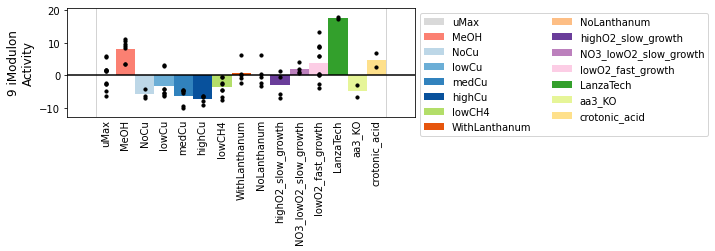

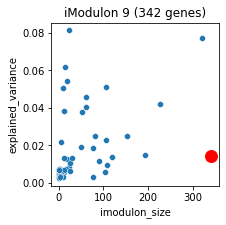

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00035,-0.040490,NaN,7350,7734,1,hypothetical protein,X,No COG annotation,A0A4P9UL31,2826,EQU24_RS00035,WP_014146528.1,||None,NaN,[]
EQU24_RS00040,-0.030201,NaN,7818,9075,1,TolC family protein,M,Cell wall/membrane/envelope biogenesis,A0A4P9UI68,2825,EQU24_RS00055 // EQU24_RS00050 // EQU24_RS0004...,WP_017841467.1,||None,efflux transmembrane transporter activity\ntra...,['efflux transmembrane transporter activity' '...
EQU24_RS00105,-0.064033,crp,24340,24994,-1,cAMP-activated global transcriptional regulato...,K,Transcription,A0A4P9UID5,2818,crp // EQU24_RS00100,WP_014146545.1,crp||crp,negative regulation of nucleic acid-templated ...,['negative regulation of nucleic acid-template...
EQU24_RS00255,-0.030624,NaN,51191,51482,1,hypothetical protein,X,No COG annotation,A0A4P9UK45,2795,EQU24_RS00255,WP_017841430.1,||None,NaN,[]
EQU24_RS00335,0.033646,NaN,73303,74293,1,hypothetical protein,X,No COG annotation,A0A4P9UIH1,2783,EQU24_RS00345 // EQU24_RS00340 // EQU24_RS0033...,WP_017841417.1,||None,sulfotransferase activity,['sulfotransferase activity']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21430,-0.032896,NaN,4826360,4826744,1,response regulator transcription factor,X,No COG annotation,A0A4P9USJ2,92,EQU24_RS21440 // EQU24_RS21435 // EQU24_RS21430,WP_017841601.1,||None,phosphorelay signal transduction system,['phosphorelay signal transduction system']
EQU24_RS21645,0.042518,NaN,4886529,4886943,-1,hypothetical protein,X,No COG annotation,UPI00034CBEF0,65,EQU24_RS21645,WP_138767255.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS21750,-0.031162,NaN,4904690,4905464,-1,DUF3450 domain-containing protein,D,"Cell cycle control, cell division, chromosome ...",A0A4P9UXK0,50,EQU24_RS21750 // EQU24_RS21745 // EQU24_RS2174...,WP_017841551.1,||None,NaN,[]


In [51]:
imod_info(9)

In [52]:
ica_data.imodulon_table.loc[9,'function'] = 'large-unclear_EW'


## iMod 10

iModulon 10


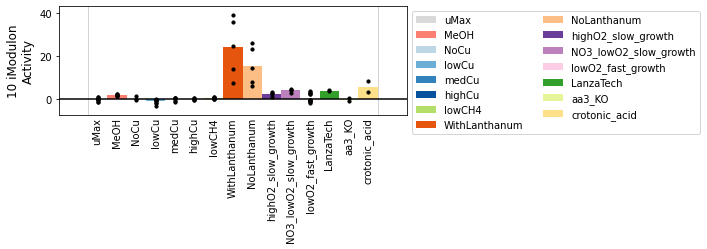

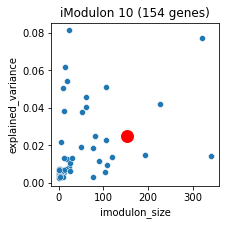

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
1,10,NaN,0.000024,0.008043,0.032468,0.454545,0.060606,5.0,11.0,154.0,KEGG modules,M00742,NaN,NaN
2,10,NaN,0.000048,0.008148,0.019481,1.000000,0.038217,3.0,3.0,154.0,KEGG modules,M00087,NaN,beta-Oxidation


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00090,0.041475,thyA,22412,23246,1,thymidylate synthase,F,Nucleotide transport and metabolism,A0A4P9UL39,2820,thyA // EQU24_RS00085,WP_017841458.1,thyA||thyA,pyrimidine deoxyribonucleoside monophosphate c...,['pyrimidine deoxyribonucleoside monophosphate...
EQU24_RS00095,0.070139,NaN,23251,23782,-1,hypothetical protein,X,No COG annotation,A0A4P9UI81,2819,EQU24_RS00095,WP_017841457.1,||None,hydrolase activity,['hydrolase activity']
EQU24_RS00160,0.036401,NaN,36419,36716,-1,hypothetical protein,X,No COG annotation,A0A4P9UIE4,2811,EQU24_RS00160,WP_017841445.1,||None,membrane,['membrane']
EQU24_RS00190,-0.043940,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00455,0.037466,tatA,96158,96371,1,twin-arginine translocase TatA/TatE family sub...,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UIV2,2769,tatC // tatB // tatA,WP_017841396.1,tatA||tatA,amide transport\npeptide transport\npeptide se...,['amide transport' 'peptide transport' 'peptid...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS22065,0.047569,NaN,4983178,4984960,-1,VWA domain-containing protein,S,Function unknown,NaN,9,EQU24_RS22085 // EQU24_RS22080 // EQU24_RS2207...,WP_017841489.1,||None,integral component of membrane\nprotein binding,['integral component of membrane' 'protein bin...
EQU24_RS22070,0.045948,NaN,4984959,4985940,-1,VWA domain-containing protein,S,Function unknown,A0A4P9UVF8,9,EQU24_RS22085 // EQU24_RS22080 // EQU24_RS2207...,WP_017841488.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS22075,0.059475,NaN,4985936,4986413,-1,DUF4381 domain-containing protein,S,Function unknown,A0A4P9USW0,9,EQU24_RS22085 // EQU24_RS22080 // EQU24_RS2207...,WP_017841487.1,||None,integral component of membrane,['integral component of membrane']


In [53]:
imod_info(10)

In [54]:
ica_data.imodulon_table.loc[10,'function'] = 'fatty-acid-beta-oxidation/membrane?_EW'


## iMod 11

iModulon 11


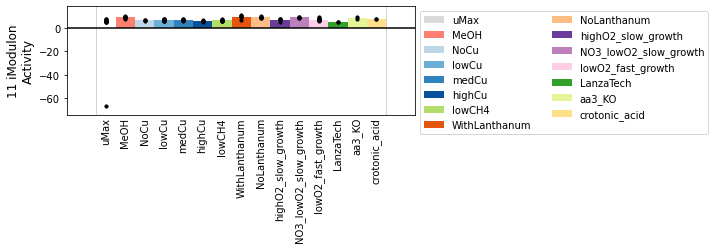

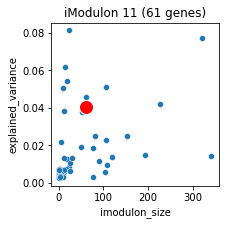

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00075,0.153923,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00180,0.091047,NaN,40588,41767,1,ISAzo13 family transposase,L,"Replication, recombination and repair",UPI00110C954A,2807,EQU24_RS00180,WP_138767046.1,||None,DNA binding,['DNA binding']
EQU24_RS00190,0.148827,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS01120,0.149001,NaN,229638,229887,-1,hypothetical protein,X,No COG annotation,A0A4P9UIY2,2674,EQU24_RS01120,WP_017841274.1,||None,NaN,[]
EQU24_RS01165,0.147324,NaN,235384,235645,-1,hypothetical protein,C,Energy production and conversion,NaN,2669,EQU24_RS01165 // EQU24_RS01160,NaN,||,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS19100,0.146708,NaN,4273940,4274030,-1,hypothetical protein,X,No COG annotation,NaN,414,EQU24_RS19100,NaN,||,NaN,[]
EQU24_RS19665,0.114862,NaN,4420900,4421098,1,hypothetical protein,X,No COG annotation,NaN,334,EQU24_RS19665,NaN,||,NaN,[]
EQU24_RS19915,0.145902,NaN,4474858,4475002,1,hypothetical protein,X,No COG annotation,NaN,304,EQU24_RS19915,NaN,||,nucleotide binding\nintegral component of memb...,['nucleotide binding' 'integral component of m...


In [55]:
imod_info(11)

In [56]:
ica_data.imodulon_table.loc[11,'function'] = 'FM20_TR1_QC-outlier-response_EW'


## iMod 12

iModulon 12


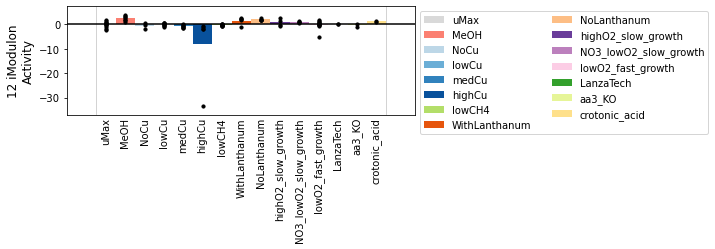

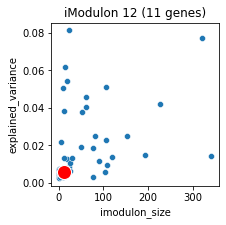

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00175,0.151579,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS03455,0.192273,NaN,734828,735008,-1,hypothetical protein,X,No COG annotation,NaN,2375,EQU24_RS03455,NaN,||,NaN,[]
EQU24_RS05420,0.284216,NaN,1163549,1163954,1,biopolymer transporter ExbD,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UMI9,2154,EQU24_RS05430 // EQU24_RS05425 // EQU24_RS05420,WP_014149416.1,||None,protein transport\nplasma membrane\nintegral c...,['protein transport' 'plasma membrane' 'integr...
EQU24_RS09095,0.243083,NaN,2011099,2011279,-1,hypothetical protein,X,No COG annotation,NaN,1680,EQU24_RS09095 // EQU24_RS09090 // EQU24_RS09085,NaN,||,peptidyl-histidine phosphorylation\nATP bindin...,['peptidyl-histidine phosphorylation' 'ATP bin...
EQU24_RS10680,0.152641,NaN,2374756,2375617,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI0015862106,1488,EQU24_RS10685 // EQU24_RS10680,WP_175421679.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS14480,0.293429,NaN,3237002,3237146,-1,DUF3096 domain-containing protein,S,Function unknown,UPI00022CF931,1014,EQU24_RS14480,WP_014148969.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS14930,0.167363,NaN,3328929,3329181,-1,hypothetical protein,X,No COG annotation,NaN,947,EQU24_RS14930,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS16375,0.236003,NaN,3677719,3678100,-1,hypothetical protein,X,No COG annotation,UPI00110CDF10,754,EQU24_RS16375,WP_138767202.1,||None,NaN,[]
EQU24_RS20320,0.285967,NaN,4585274,4585535,-1,DUF2442 domain-containing protein,S,Function unknown,A0A4P9UV61,252,EQU24_RS20320,WP_017841802.1,||None,NaN,[]


In [57]:
imod_info(12)

In [58]:
ica_data.imodulon_table.loc[12,'function'] = 'some-membrane/outlier-response-highCu_T6_EW'


## iMod 13

iModulon 13


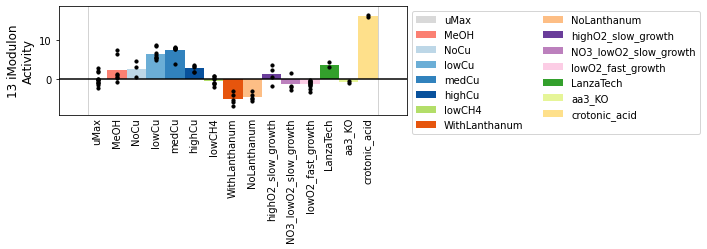

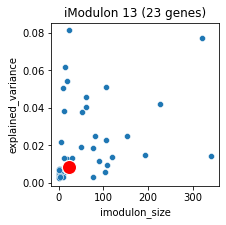

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
3,13,NaN,0.000085,0.028988,0.086957,0.666667,0.153846,2.0,3.0,23.0,KEGG modules,M00642,NaN,"Multidrug resistance, efflux pump MexJK-OprM"


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00680,0.147515,NaN,142316,143699,-1,selenium-binding protein,S,Function unknown,NaN,2738,EQU24_RS00680,WP_235726469.1,||None,selenium binding,['selenium binding']
EQU24_RS00685,0.135201,NaN,143798,144074,-1,DUF4242 domain-containing protein,S,Function unknown,A0A4P9UIM5,2737,EQU24_RS00685,WP_017841355.1,||None,NaN,[]
EQU24_RS00690,0.111105,NaN,144127,144724,-1,TetR family transcriptional regulator,K,Transcription,A0A4V1IJC6,2736,EQU24_RS00690,WP_017841354.1,||None,DNA binding,['DNA binding']
EQU24_RS01670,0.082616,NaN,352356,352530,-1,DUF2292 domain-containing protein,X,No COG annotation,A0A4P9UJ24,2600,EQU24_RS01670,WP_014146765.1,||None,NaN,[]
EQU24_RS02055,-0.071370,NaN,432512,434726,1,TonB-dependent receptor,P,Inorganic ion transport and metabolism,NaN,2549,EQU24_RS02055,WP_235726409.1,||None,cell outer membrane\nintegral component of mem...,['cell outer membrane' 'integral component of ...
EQU24_RS09190,0.070295,NaN,2034239,2037284,-1,efflux RND transporter permease subunit,V,Defense mechanisms,UPI000347F728,1667,EQU24_RS09210 // EQU24_RS09205 // EQU24_RS0920...,WP_017839782.1,||None,integral component of membrane\ntransmembrane ...,['integral component of membrane' 'transmembra...
EQU24_RS09195,0.068470,NaN,2037301,2038423,-1,efflux RND transporter periplasmic adaptor sub...,M,Cell wall/membrane/envelope biogenesis,UPI00034C509C,1667,EQU24_RS09210 // EQU24_RS09205 // EQU24_RS0920...,WP_017839781.1,||None,plasma membrane\ntransmembrane transporter act...,['plasma membrane' 'transmembrane transporter ...
EQU24_RS09205,0.075269,NaN,2038669,2039947,-1,TolC family protein,M,Cell wall/membrane/envelope biogenesis,A0A4P9UMD4,1667,EQU24_RS09210 // EQU24_RS09205 // EQU24_RS0920...,WP_017839780.1,||None,efflux transmembrane transporter activity\ntra...,['efflux transmembrane transporter activity' '...
EQU24_RS09210,0.094738,NaN,2039933,2040548,-1,TetR/AcrR family transcriptional regulator,K,Transcription,A0A4P9UM66,1667,EQU24_RS09210 // EQU24_RS09205 // EQU24_RS0920...,WP_017839779.1,||None,DNA binding,['DNA binding']


In [59]:
imod_info(13)

In [60]:
ica_data.imodulon_table.loc[13,'function'] = 'multi-drug-resistance/TetR/membrane-transport_EW'


## iMod 14

iModulon 14


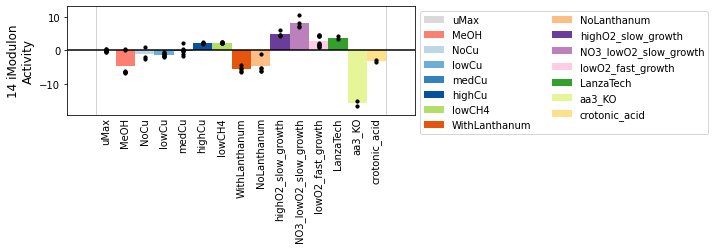

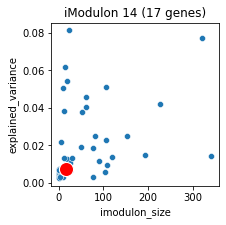

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
4,14,NaN,5.460031e-08,0.000019,0.176471,1.000000,0.300000,3.0,3.0,17.0,KEGG modules,M00641,NaN,"Multidrug resistance, efflux pump MexEF-OprN"
5,14,NaN,2.178565e-07,0.000037,0.176471,0.750000,0.285714,3.0,4.0,17.0,KEGG modules,M00769,NaN,"Multidrug resistance, efflux pump MexPQ-OpmE"
6,14,NaN,1.532813e-05,0.001042,0.117647,1.000000,0.210526,2.0,2.0,17.0,KEGG modules,M00698,NaN,"Multidrug resistance, efflux pump BpeEF-OprC"
7,14,NaN,1.532813e-05,0.001042,0.117647,1.000000,0.210526,2.0,2.0,17.0,KEGG modules,M00767,NaN,NaN
8,14,NaN,1.532813e-05,0.001042,0.117647,1.000000,0.210526,2.0,2.0,17.0,KEGG modules,M00768,NaN,NaN
1,14,NaN,9.153250e-05,0.023158,0.117647,0.500000,0.190476,2.0,4.0,17.0,KEGG pathways,map00909,Sesquiterpenoid and triterpenoid biosynthesis,NaN
9,14,NaN,3.180877e-04,0.018025,0.117647,0.285714,0.166667,2.0,7.0,17.0,KEGG modules,M00155,NaN,"Cytochrome c oxidase, prokaryotes"
10,14,NaN,1.164749e-03,0.056574,0.117647,0.153846,0.133333,2.0,13.0,17.0,KEGG modules,M00096,NaN,"C5 isoprenoid biosynthesis, non-mevalonate pat..."


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS01670,-0.105474,NaN,352356,352530,-1,DUF2292 domain-containing protein,X,No COG annotation,A0A4P9UJ24,2600,EQU24_RS01670,WP_014146765.1,||None,NaN,[]
EQU24_RS08770,0.101588,NaN,1943066,1944929,-1,1-deoxy-D-xylulose-5-phosphate synthase,H,Coenzyme transport and metabolism,A0A4P9UP60,1721,EQU24_RS08770,WP_017839846.1,||dxs,pyruvate metabolic process\nubiquinone biosynt...,['pyruvate metabolic process' 'ubiquinone bios...
EQU24_RS08775,0.127834,NaN,1944983,1946624,-1,copper resistance protein,P,Inorganic ion transport and metabolism,A0A4P9UM38,1720,EQU24_RS08785 // EQU24_RS08780 // EQU24_RS08775,WP_017839845.1,||None,copper ion transport\nintegral component of me...,['copper ion transport' 'integral component of...
EQU24_RS08780,0.130455,NaN,1946634,1946991,-1,copper resistance protein CopC,S,Function unknown,A0A4V1IJR5,1720,EQU24_RS08785 // EQU24_RS08780 // EQU24_RS08775,WP_017839844.1,||None,copper ion binding\nresponse to copper ion\npe...,['copper ion binding' 'response to copper ion'...
EQU24_RS08785,0.119338,NaN,1947024,1949652,-1,MMPL family transporter,S,Function unknown,A0A4P9URM7,1720,EQU24_RS08785 // EQU24_RS08780 // EQU24_RS08775,WP_017839843.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS10820,0.127015,NaN,2404406,2405621,1,efflux RND transporter periplasmic adaptor sub...,M,Cell wall/membrane/envelope biogenesis,A0A4P9UMU8,1466,EQU24_RS10830 // EQU24_RS10825 // EQU24_RS10820,WP_017839488.1,||None,transmembrane transporter activity\ntransmembr...,['transmembrane transporter activity' 'transme...
EQU24_RS10825,0.138752,NaN,2405627,2408813,1,multidrug efflux RND transporter permease subunit,V,Defense mechanisms,A0A4P9UQ36,1466,EQU24_RS10830 // EQU24_RS10825 // EQU24_RS10820,WP_017839487.1,||None,xenobiotic transport\nefflux transmembrane tra...,['xenobiotic transport' 'efflux transmembrane ...
EQU24_RS10830,0.107035,NaN,2408812,2410279,1,efflux transporter outer membrane subunit,M,Cell wall/membrane/envelope biogenesis,NaN,1466,EQU24_RS10830 // EQU24_RS10825 // EQU24_RS10820,WP_017839486.1,||None,cell outer membrane\nefflux transmembrane tran...,['cell outer membrane' 'efflux transmembrane t...
EQU24_RS14125,0.354348,ctaD,3155695,3157312,-1,cytochrome c oxidase subunit I,C,Energy production and conversion,A0A4P9USA4,1055,coxB // ctaD,WP_017838879.1,ctaD||ctaD,electron transport coupled proton transport\ne...,['electron transport coupled proton transport'...


In [61]:
imod_info(14)

In [62]:
ica_data.imodulon_table.loc[14,'function'] = 'multi-drug-resistance/transport/efflux-pump/low-activity-aa3KO_EW'


## iMod 15

iModulon 15


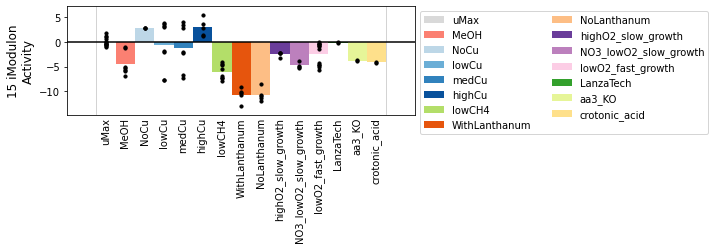

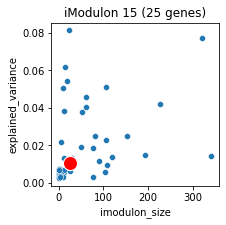

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
17,15,response to heat,9.455494e-20,3.879589e-16,0.48,0.333333,0.393443,12.0,36.0,25.0,GO,NaN,NaN,NaN
21,15,chaperone cofactor-dependent protein refolding,1.595743e-13,9.353331e-11,0.24,0.857143,0.375000,6.0,7.0,25.0,GO,NaN,NaN,NaN
23,15,'de novo' post-translational protein folding,1.595743e-13,9.353331e-11,0.24,0.857143,0.375000,6.0,7.0,25.0,GO,NaN,NaN,NaN
20,15,unfolded protein binding,1.866999e-14,1.915075e-11,0.32,0.444444,0.372093,8.0,18.0,25.0,GO,NaN,NaN,NaN
25,15,'de novo' protein folding,1.900091e-12,8.662306e-10,0.24,0.666667,0.352941,6.0,9.0,25.0,GO,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,15,biological_process,1.863006e-04,1.087283e-02,0.60,0.014354,0.028037,15.0,1045.0,25.0,GO,NaN,NaN,NaN
129,15,catalytic activity,2.353712e-03,8.546266e-02,0.44,0.014455,0.027990,11.0,761.0,25.0,GO,NaN,NaN,NaN
102,15,molecular_function,4.151138e-04,1.980479e-02,0.56,0.014242,0.027778,14.0,983.0,25.0,GO,NaN,NaN,NaN
124,15,cellular process,2.101139e-03,7.909151e-02,0.48,0.013714,0.026667,12.0,875.0,25.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00205,-0.078947,NaN,44526,46077,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2803,EQU24_RS00205,WP_244310896.1,||None,NaN,[]
EQU24_RS00670,0.095130,NaN,139733,140330,1,hypothetical protein,X,No COG annotation,A0A4P9ULC6,2740,EQU24_RS00670,WP_017841358.1,||None,NaN,[]
EQU24_RS01215,-0.124356,NaN,244910,246461,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2664,EQU24_RS01215,WP_040575330.1,||None,NaN,[]
EQU24_RS05870,0.093900,NaN,1279697,1281167,1,hypothetical protein,C,Energy production and conversion,A0A4P9UKY7,2090,EQU24_RS05875 // EQU24_RS05870,WP_017840383.1,||None,heme binding\nelectron transport chain\nmetal ...,['heme binding' 'electron transport chain' 'me...
EQU24_RS05880,0.091203,NaN,1282606,1282858,1,hypothetical protein,X,No COG annotation,A0A4P9UMR5,2089,EQU24_RS05880,WP_017840380.1,||None,NaN,[]
EQU24_RS08645,0.142696,moeB,1914913,1915657,-1,molybdopterin-synthase adenylyltransferase MoeB,H,Coenzyme transport and metabolism,A0A4P9ULY6,1738,moeB,WP_017839871.1,moeB||moeB,molybdopterin-synthase adenylyltransferase act...,['molybdopterin-synthase adenylyltransferase a...
EQU24_RS08650,0.246743,groS,1915795,1916083,1,co-chaperone GroES,O,"Post-translational modification, protein turno...",A0A4P9UP67,1737,EQU24_RS08650,WP_017839870.1,||groES,ATP binding\nmetal ion binding\nGroEL-GroES co...,['ATP binding' 'metal ion binding' 'GroEL-GroE...
EQU24_RS08655,0.246046,groL,1916139,1917798,1,chaperonin GroEL,O,"Post-translational modification, protein turno...",A0A4P9UPY3,1736,groL,WP_017839869.1,groL||groL,ATP hydrolysis activity\npositive regulation o...,['ATP hydrolysis activity'\n 'positive regulat...
EQU24_RS08660,0.168892,NaN,1917885,1918140,1,transcriptional regulator,K,Transcription,A0A4P9UM01,1735,EQU24_RS08660,WP_017839868.1,||None,NaN,[]


In [63]:
imod_info(15)

In [64]:
ica_data.imodulon_table.loc[15,'function'] = 'groEL/ES-post-translation-mod_EW'


## iMod 16

iModulon 16


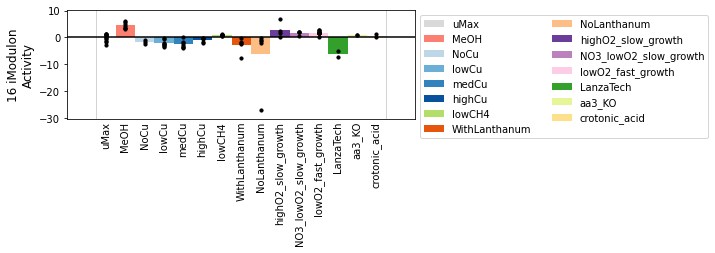

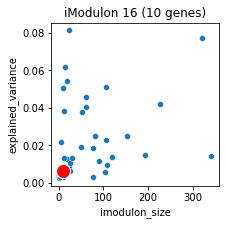

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00075,-0.139476,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00185,0.172491,NaN,42145,42478,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIJ4,2806,EQU24_RS00185,WP_017841440.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS01150,0.192288,NaN,234038,234461,1,hypothetical protein,X,No COG annotation,A0A4P9UIU6,2671,EQU24_RS01150,WP_017841268.1,||None,NaN,[]
EQU24_RS01765,0.184051,NaN,371879,372134,-1,DUF504 domain-containing protein,A,RNA processing and modification,A0A4P9ULU4,2590,EQU24_RS01765,WP_017841154.1,||None,NaN,[]
EQU24_RS05320,0.169224,cobS,1131915,1132662,-1,adenosylcobinamide-GDP ribazoletransferase,H,Coenzyme transport and metabolism,A0A4P9UMQ7,2166,cobS // cobC // EQU24_RS05310 // EQU24_RS05305,WP_017840486.1,cobS||cobS,cobalamin biosynthetic process\ncobalamin 5'-p...,"['cobalamin biosynthetic process'\n ""cobalamin..."
EQU24_RS06205,0.147534,NaN,1352804,1353026,-1,hypothetical protein,X,No COG annotation,NaN,2050,EQU24_RS06205,NaN,||,phosphorelay signal transduction system\ninteg...,['phosphorelay signal transduction system'\n '...
EQU24_RS08455,0.161118,urtB,1866865,1867792,1,urea ABC transporter permease subunit UrtB,E,Amino acid transport and metabolism,A0A4V1IJQ9,1762,EQU24_RS08475 // urtE // urtD // urtC // urtB,WP_017839901.1,urtB||urtB,plasma membrane\nintegral component of membran...,['plasma membrane' 'integral component of memb...
EQU24_RS09570,0.136470,NaN,2126800,2127205,1,hypothetical protein,X,No COG annotation,UPI00034DDA72,1616,EQU24_RS09570,WP_138767143.1,||None,NaN,[]
EQU24_RS11970,0.165055,NaN,2677956,2678349,-1,hypothetical protein,Q,"Secondary metabolites biosynthesis, transport,...",A0A4P9URC2,1322,EQU24_RS11970 // EQU24_RS11965,WP_051056233.1,||None,"hydrolase activity, acting on ester bonds\npho...","['hydrolase activity, acting on ester bonds' '..."


In [65]:
imod_info(16)

In [66]:
ica_data.imodulon_table.loc[16,'function'] = 'unclear/outlier-response-vial-woLa_EW'


## iMod 17

iModulon 17


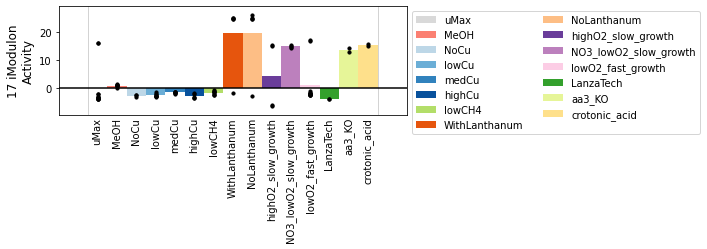

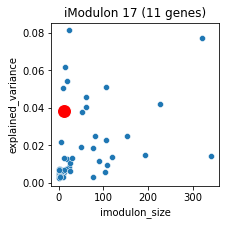

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
132,17,transposase activity,2.056164e-09,0.000005,0.545455,0.105263,0.176471,6.0,57.0,11.0,GO,NaN,NaN,NaN
133,17,"transposition, DNA-mediated",2.547796e-09,0.000005,0.545455,0.101695,0.171429,6.0,59.0,11.0,GO,NaN,NaN,NaN
134,17,DNA binding,1.514139e-07,0.000207,0.727273,0.024691,0.047761,8.0,324.0,11.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00205,0.124992,NaN,44526,46077,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2803,EQU24_RS00205,WP_244310896.1,||None,NaN,[]
EQU24_RS04160,0.148447,NaN,874502,874683,-1,NaN,X,No COG annotation,NaN,2308,EQU24_RS04170 // EQU24_RS04165 // ssrS // EQU2...,NaN,||,NaN,[]
EQU24_RS05675,0.170768,NaN,1225286,1226585,1,transposase,L,"Replication, recombination and repair",UPI00110CA81F,2119,EQU24_RS05675,WP_138767097.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS06200,0.250665,NaN,1352012,1352726,-1,transposase,L,"Replication, recombination and repair",NaN,2051,EQU24_RS06200,WP_138767106.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS06885,0.180643,NaN,1513567,1514488,-1,Rpn family recombination-promoting nuclease/pu...,S,Function unknown,A0A4P9UQW1,1956,EQU24_RS06885,WP_014149136.1,||None,NaN,[]
EQU24_RS12805,0.116343,NaN,2872306,2873593,1,IS4 family transposase,L,"Replication, recombination and repair",NaN,1225,EQU24_RS12805,WP_244310887.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS14960,0.286558,NaN,3336399,3337698,-1,transposase,L,"Replication, recombination and repair",UPI00110CA81F,942,EQU24_RS14960,WP_138767097.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS17670,0.261085,NaN,3940109,3941288,1,ISAzo13 family transposase,L,"Replication, recombination and repair",UPI00110D0AC0,594,EQU24_RS17670,WP_138767139.1,||None,DNA binding,['DNA binding']
EQU24_RS18390,0.201264,NaN,4104697,4105996,1,transposase,L,"Replication, recombination and repair",UPI00110CA81F,506,EQU24_RS18390,WP_138767097.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [67]:
imod_info(17)

In [68]:
ica_data.imodulon_table.loc[17,'function'] = 'transposase_EW'


## iMod 18

iModulon 18


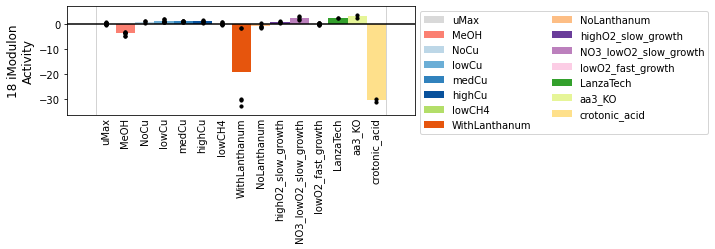

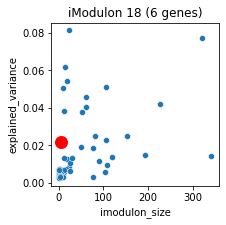

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
135,18,alcohol dehydrogenase (cytochrome c(L)) activity,0.000002,0.006937,0.333333,1.000000,0.500000,2.0,6.0,6.0,GO,NaN,NaN,NaN
9,18,NaN,0.000047,0.005965,0.333333,0.250000,0.285714,2.0,8.0,6.0,KEGG pathways,map00625,Chloroalkane and chloroalkene degradation,NaN
11,18,NaN,0.000153,0.051911,0.333333,0.142857,0.200000,2.0,14.0,6.0,KEGG modules,M00174,NaN,"Methane oxidation, methanotroph, methane => fo..."
136,18,periplasmic space,0.000043,0.088762,0.500000,0.053571,0.096774,3.0,56.0,6.0,GO,NaN,NaN,NaN
8,18,NaN,0.000002,0.000381,0.666667,0.051948,0.096386,4.0,77.0,6.0,KEGG pathways,map00680,Methane metabolism,NaN
11,18,NaN,0.001042,0.065929,0.333333,0.055556,0.095238,2.0,36.0,6.0,KEGG pathways,map00010,Glycolysis / Gluconeogenesis,NaN
10,18,NaN,0.000284,0.023921,0.666667,0.013937,0.027304,4.0,287.0,6.0,KEGG pathways,map01120,Microbial metabolism in diverse environments,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS18090,0.144705,mxaL,4033529,4034459,-1,VWA domain-containing protein,S,Function unknown,A0A4P9UR53,548,EQU24_RS18090,WP_017842215.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS18095,0.191966,mxaK,4035093,4035654,-1,MxaK protein,X,No COG annotation,A0A4P9UR46,547,EQU24_RS18100 // EQU24_RS18095,WP_017842214.1,||None,integral component of membrane\nprotein binding,['integral component of membrane' 'protein bin...
EQU24_RS18100,0.214711,mxaC,4035650,4036583,-1,VWA domain-containing protein,S,Function unknown,NaN,547,EQU24_RS18100 // EQU24_RS18095,WP_017842213.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS18105,0.225251,mxaA,4036630,4037554,-1,hypothetical protein,X,No COG annotation,A0A4P9UTJ7,546,EQU24_RS18105,WP_017842212.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS18110,0.254079,mxaS,4038027,4038882,-1,MxaS protein,S,Function unknown,A0A4P9UU55,545,EQU24_RS18115 // EQU24_RS18110,WP_017842211.1,||None,NaN,[]
EQU24_RS18115,0.226066,mxaP,4038883,4039510,-1,hypothetical protein,X,No COG annotation,A0A4P9UR48,545,EQU24_RS18115 // EQU24_RS18110,WP_017842210.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS18120,0.255468,moxR,4040146,4041163,-1,MoxR family ATPase,S,Function unknown,A0A4P9UTL4,544,EQU24_RS18120,WP_017842209.1,||None,ATP hydrolysis activity\nATP binding\ncytoplas...,['ATP hydrolysis activity' 'ATP binding' 'cyto...
EQU24_RS18125,0.308738,moxI,4041358,4041643,-1,methanol dehydrogenase,M,Cell wall/membrane/envelope biogenesis,A0A4P9UR50,543,moxJ // moxG // EQU24_RS18125,WP_017842208.1,||None,alcohol dehydrogenase (NAD+) activity\nmethano...,['alcohol dehydrogenase (NAD+) activity' 'meth...
EQU24_RS18130,0.338676,moxG,4041660,4042134,-1,"cytochrome c(L), periplasmic",C,Energy production and conversion,A0A4V1IK77,543,moxJ // moxG // EQU24_RS18125,WP_017842207.1,moxG||moxG,iron ion binding\nheme binding\nelectron trans...,['iron ion binding' 'heme binding' 'electron t...


In [71]:
imod_info(18)

In [74]:
ica_data.imodulon_table.loc[18,'category'] = 'functional'
ica_data.imodulon_table.loc[18,'function'] = 'mxa-gene-cluster_EW'
ica_data.change_threshold(18, 0.14)


## iMod 19

iModulon 19


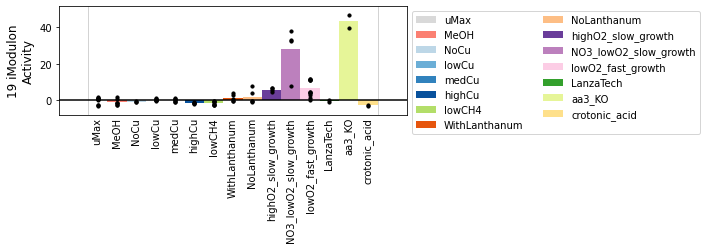

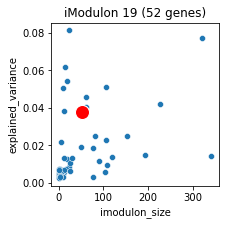

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
137,19,nitrogen fixation,3.164588e-24,1.298431e-20,0.269231,0.736842,0.394366,14.0,19.0,52.0,GO,NaN,NaN,NaN
138,19,electron transport chain,1.429114e-10,2.931827e-07,0.230769,0.146341,0.179104,12.0,82.0,52.0,GO,NaN,NaN,NaN
139,19,nitrogenase activity,2.355346e-10,3.221329e-07,0.096154,1.000000,0.175439,5.0,5.0,52.0,GO,NaN,NaN,NaN
141,19,electron transfer activity,7.023521e-08,5.763501e-05,0.173077,0.136364,0.152542,9.0,66.0,52.0,GO,NaN,NaN,NaN
140,19,carbonyl sulfide nitrogenase activity,2.065344e-08,2.118527e-05,0.076923,1.000000,0.142857,4.0,4.0,52.0,GO,NaN,NaN,NaN
142,19,iron-sulfur cluster binding,3.714255e-06,2.539931e-03,0.134615,0.127273,0.130841,7.0,55.0,52.0,GO,NaN,NaN,NaN
12,19,NaN,1.774510e-06,6.033334e-04,0.057692,1.000000,0.109091,3.0,3.0,52.0,KEGG modules,M00175,NaN,"Nitrogen fixation, nitrogen => ammonia"
12,19,NaN,9.511375e-05,2.406378e-02,0.057692,0.375000,0.100000,3.0,8.0,52.0,KEGG pathways,map00625,Chloroalkane and chloroalkene degradation,NaN
143,19,molybdenum-iron nitrogenase complex,1.494492e-04,8.759860e-02,0.038462,1.000000,0.074074,2.0,2.0,52.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS17060,0.101162,NaN,3835643,3836495,-1,hypothetical protein,S,Function unknown,A0A4P9UVM3,668,EQU24_RS17060,WP_017842416.1,||None,NaN,[]
EQU24_RS17065,0.173827,nifH,3837050,3837932,1,nitrogenase iron protein,P,Inorganic ion transport and metabolism,A0A4P9UQY6,667,nifH,WP_017842415.1,nifH||nifH,nitrogenase activity\ncarbonyl sulfide nitroge...,['nitrogenase activity' 'carbonyl sulfide nitr...
EQU24_RS17070,0.176369,nifD,3838069,3839548,1,nitrogenase molybdenum-iron protein alpha chain,C,Energy production and conversion,A0A4P9UQQ6,666,nifD,WP_017842414.1,nifD||nifD,nitrogenase activity\ncarbonyl sulfide nitroge...,['nitrogenase activity' 'carbonyl sulfide nitr...
EQU24_RS17075,0.172999,nifK,3839690,3841262,1,nitrogenase molybdenum-iron protein subunit beta,F,Nucleotide transport and metabolism,A0A4P9UQP4,665,nifK,WP_017842413.1,nifK||nifK,nitrogenase activity\ncarbonyl sulfide nitroge...,['nitrogenase activity' 'carbonyl sulfide nitr...
EQU24_RS17080,0.164754,nifT,3841334,3841547,1,putative nitrogen fixation protein NifT,Q,"Secondary metabolites biosynthesis, transport,...",A0A4P9UT74,664,EQU24_RS17100 // EQU24_RS17095 // EQU24_RS1709...,WP_017842412.1,nifT||nifT,nitrogen fixation,['nitrogen fixation']
EQU24_RS17085,0.177285,NaN,3841557,3841758,1,4Fe-4S dicluster domain-containing protein,C,Energy production and conversion,A0A4P9UTR2,664,EQU24_RS17100 // EQU24_RS17095 // EQU24_RS1709...,WP_017842411.1,||None,NaN,[]
EQU24_RS17090,0.151574,NaN,3841761,3842028,1,hypothetical protein,X,No COG annotation,A0A4P9UQP9,664,EQU24_RS17100 // EQU24_RS17095 // EQU24_RS1709...,WP_017842410.1,||None,NaN,[]
EQU24_RS17095,0.124565,NaN,3842037,3842802,1,hypothetical protein,C,Energy production and conversion,A0A4P9UT91,664,EQU24_RS17100 // EQU24_RS17095 // EQU24_RS1709...,WP_017842409.1,||None,NaN,[]
EQU24_RS17100,0.106676,NaN,3842794,3843757,1,hypothetical protein,X,No COG annotation,A0A4P9UQQ0,664,EQU24_RS17100 // EQU24_RS17095 // EQU24_RS1709...,WP_017842408.1,||None,NaN,[]


In [72]:
imod_info(19)

In [73]:
ica_data.imodulon_table.loc[19,'category'] = 'functional'
ica_data.imodulon_table.loc[19,'function'] = 'nif/electron-transport_EW'


## iMod 20

iModulon 20


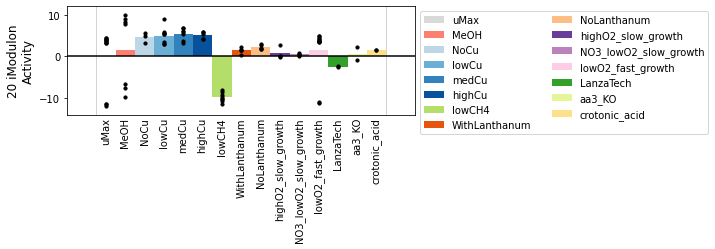

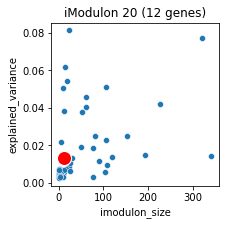

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS05090,0.106586,NaN,1086306,1086642,-1,hypothetical protein,X,No COG annotation,NaN,2189,EQU24_RS05090,NaN,||,hydrolase activity,['hydrolase activity']
EQU24_RS05635,0.151173,NaN,1220732,1220808,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]
EQU24_RS07375,0.194324,NaN,1630411,1630488,1,NaN,X,No COG annotation,NaN,1895,infC // thrS // EQU24_RS07375,NaN,||,NaN,[]
EQU24_RS07995,0.130945,NaN,1765410,1766609,-1,IS3 family transposase,L,"Replication, recombination and repair",UPI00110CA4C7,1825,EQU24_RS07995,WP_138767126.1,||None,DNA integration\nsequence-specific DNA binding...,['DNA integration' 'sequence-specific DNA bind...
EQU24_RS08855,0.192720,NaN,1962417,1963410,1,hypothetical protein,S,Function unknown,A0A4P9UM20,1709,EQU24_RS08855,WP_017839829.1,||None,NaN,[]
EQU24_RS10780,0.152145,NaN,2397391,2397468,-1,NaN,X,No COG annotation,NaN,1474,EQU24_RS10780,NaN,||,NaN,[]
EQU24_RS12815,0.226326,NaN,2875910,2876903,-1,cytosolic protein,S,Function unknown,UPI00110CE264,1223,EQU24_RS12815,WP_138767173.1,||None,NaN,[]
EQU24_RS15125,0.109026,NaN,3379487,3379572,-1,NaN,X,No COG annotation,NaN,920,EQU24_RS15125,NaN,||,NaN,[]
EQU24_RS17665,0.132222,NaN,3938733,3940029,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI00110CD44A,595,EQU24_RS17665,WP_138767208.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [75]:
imod_info(20)

In [76]:
ica_data.imodulon_table.loc[20,'function'] = 'low-in-CH4/some-split-conditions/some-transposase_EW'


## iMod 21

iModulon 21


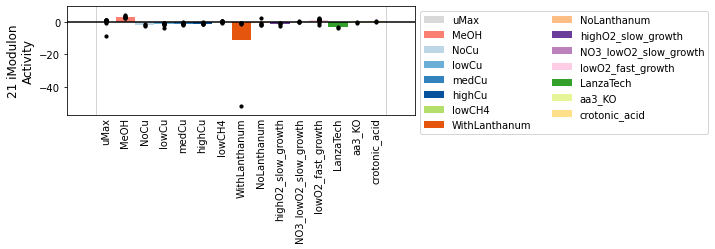

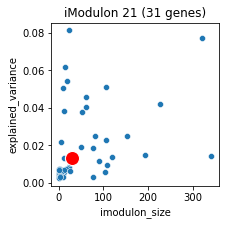

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00195,0.133660,NaN,42874,43876,-1,DUF4338 domain-containing protein,L,"Replication, recombination and repair",NaN,2805,EQU24_RS00195 // EQU24_RS00190,WP_235726418.1,||None,NaN,[]
EQU24_RS01125,0.159255,NaN,229960,230614,1,hypothetical protein,X,No COG annotation,A0A4P9UIP8,2673,EQU24_RS01140 // EQU24_RS01135 // EQU24_RS0113...,WP_017841273.1,||None,NaN,[]
EQU24_RS01155,0.171328,NaN,234648,234873,1,hypothetical protein,X,No COG annotation,UPI0009FE04B7,2670,EQU24_RS01155,WP_083877732.1,||None,NaN,[]
EQU24_RS01170,0.127262,NaN,235812,237102,-1,Y-family DNA polymerase,L,"Replication, recombination and repair",A0A4P9UIZ1,2668,umuD // EQU24_RS01170,WP_017841266.1,||None,ATP hydrolysis activity\nATP hydrolysis activi...,['ATP hydrolysis activity' 'ATP hydrolysis act...
EQU24_RS01175,0.092831,umuD,237101,237485,-1,translesion error-prone DNA polymerase V autop...,K,Transcription,UPI00191C1247,2668,umuD // EQU24_RS01170,WP_201764864.1,umuD||umuD,"regulation of transcription, DNA-templated\nDN...","['regulation of transcription, DNA-templated' ..."
EQU24_RS01260,0.167628,NaN,254824,255316,1,hypothetical protein,X,No COG annotation,A0A4P9UL13,2659,EQU24_RS01265 // EQU24_RS01260,WP_017841246.1,||None,NaN,[]
EQU24_RS01555,0.093363,NaN,328948,329197,1,hypothetical protein,X,No COG annotation,NaN,2616,EQU24_RS01555,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS01765,-0.107452,NaN,371879,372134,-1,DUF504 domain-containing protein,A,RNA processing and modification,A0A4P9ULU4,2590,EQU24_RS01765,WP_017841154.1,||None,NaN,[]
EQU24_RS05305,0.144156,NaN,1129473,1129971,-1,bifunctional adenosylcobinamide kinase/adenosy...,H,Coenzyme transport and metabolism,A0A4P9UMG7,2166,cobS // cobC // EQU24_RS05310 // EQU24_RS05305,WP_017840489.1,||None,cobalamin biosynthetic process\ncobinamide pho...,['cobalamin biosynthetic process'\n 'cobinamid...


In [77]:
imod_info(21)

In [78]:
ica_data.imodulon_table.loc[21,'function'] = 'unclear/outlier-response-wLa-vial_EW'


## iMod 22

iModulon 22


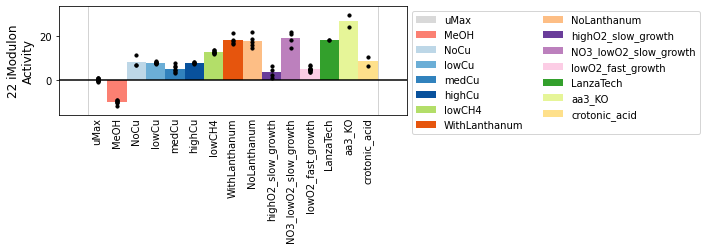

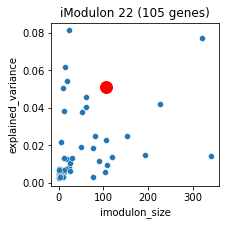

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
13,22,NaN,4.741615e-07,0.000120,0.085714,0.219512,0.123288,9.0,41.0,105.0,KEGG pathways,map00910,Nitrogen metabolism,NaN
18,22,NaN,3.008887e-04,0.017050,0.038095,0.285714,0.067227,4.0,14.0,105.0,KEGG modules,M00174,NaN,"Methane oxidation, methanotroph, methane => fo..."
14,22,NaN,1.505202e-05,0.005025,0.028571,1.000000,0.055556,3.0,3.0,105.0,KEGG modules,M00641,NaN,"Multidrug resistance, efflux pump MexEF-OprN"
13,22,NaN,5.911404e-05,0.005025,0.028571,0.750000,0.055046,3.0,4.0,105.0,KEGG modules,M00528,NaN,"Nitrification, ammonia => nitrite"
15,22,NaN,5.911404e-05,0.005025,0.028571,0.750000,0.055046,3.0,4.0,105.0,KEGG modules,M00769,NaN,"Multidrug resistance, efflux pump MexPQ-OpmE"
16,22,NaN,5.911404e-05,0.005025,0.028571,0.750000,0.055046,3.0,4.0,105.0,KEGG modules,M00804,NaN,"Complete nitrification, comammox, ammonia => n..."
17,22,NaN,1.451025e-04,0.009867,0.028571,0.600000,0.054545,3.0,5.0,105.0,KEGG modules,M00529,NaN,"Denitrification, nitrate => nitrogen"
19,22,NaN,6.153792e-04,0.023248,0.019048,1.000000,0.037383,2.0,2.0,105.0,KEGG modules,M00698,NaN,"Multidrug resistance, efflux pump BpeEF-OprC"
20,22,NaN,6.153792e-04,0.023248,0.019048,1.000000,0.037383,2.0,2.0,105.0,KEGG modules,M00767,NaN,NaN
21,22,NaN,6.153792e-04,0.023248,0.019048,1.000000,0.037383,2.0,2.0,105.0,KEGG modules,M00768,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00125,0.045403,NaN,29783,31106,1,autotransporter outer membrane beta-barrel dom...,S,Function unknown,UPI000A00FB62,2815,EQU24_RS00125,WP_083877750.1,||None,palmitoyl-CoA hydrolase activity\nacyl-CoA hyd...,['palmitoyl-CoA hydrolase activity' 'acyl-CoA ...
EQU24_RS00160,0.078559,NaN,36419,36716,-1,hypothetical protein,X,No COG annotation,A0A4P9UIE4,2811,EQU24_RS00160,WP_017841445.1,||None,membrane,['membrane']
EQU24_RS00590,0.057577,NaN,122491,123085,1,hypothetical protein,X,No COG annotation,A0A4P9UIF8,2751,EQU24_RS00590,WP_026130247.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS00880,-0.042492,NaN,183210,183432,1,hypothetical protein,X,No COG annotation,A0A4P9UIU9,2712,EQU24_RS00880,WP_017841320.1,||None,NaN,[]
EQU24_RS00990,0.060486,aqpZ,203431,204151,1,aquaporin Z,G,Carbohydrate transport and metabolism,NaN,2695,aqpZ,WP_235726467.1,aqpZ||aqpZ,water homeostasis\nwater transport\nregulation...,['water homeostasis' 'water transport' 'regula...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS19970,0.102862,NaN,4489396,4490098,1,transcription antitermination protein NusG,S,Function unknown,A0A4P9UV12,298,EQU24_RS19970,WP_017841866.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS20335,-0.040907,NaN,4587226,4587418,-1,hypothetical protein,X,No COG annotation,NaN,249,EQU24_RS20335,NaN,||,NaN,[]
EQU24_RS20510,-0.053135,NaN,4626446,4626638,-1,hypothetical protein,X,No COG annotation,NaN,227,EQU24_RS20510 // EQU24_RS20505,NaN,||,integral component of membrane,['integral component of membrane']


In [79]:
imod_info(22)

In [80]:
ica_data.imodulon_table.loc[22,'function'] = 'methane-oxidation/nitrification/multi-drug-restistance_EW'


## iMod 23

iModulon 23


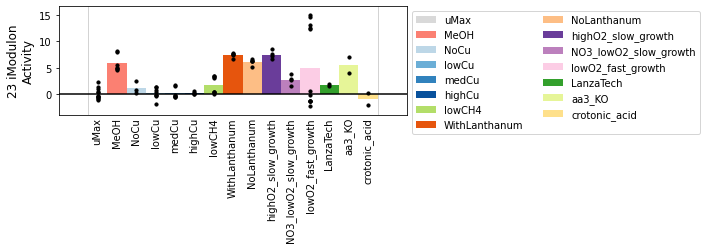

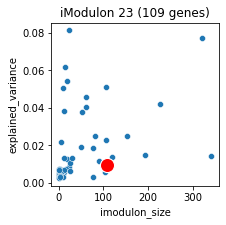

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
23,23,NaN,0.000017,0.005731,0.027523,1.0,0.053571,3.0,3.0,109.0,KEGG modules,M00175,NaN,"Nitrogen fixation, nitrogen => ammonia"
24,23,NaN,0.000162,0.027585,0.027523,0.6,0.052632,3.0,5.0,109.0,KEGG modules,M00240,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00165,0.038057,NaN,36832,37129,-1,hypothetical protein,X,No COG annotation,A0A4V1IJB7,2810,EQU24_RS00165,WP_017841444.1,||None,NaN,[]
EQU24_RS00470,-0.051236,NaN,97499,98117,-1,GDSL family lipase,E,Amino acid transport and metabolism,A0A4P9UK91,2768,EQU24_RS00470,WP_017841393.1,||None,NaN,[]
EQU24_RS00940,-0.075355,NaN,193739,193970,1,hypothetical protein,X,No COG annotation,A0A4P9UIM7,2704,EQU24_RS00940,WP_017841310.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS01215,-0.060606,NaN,244910,246461,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2664,EQU24_RS01215,WP_040575330.1,||None,NaN,[]
EQU24_RS01375,0.038379,NaN,286650,287097,-1,hypothetical protein,X,No COG annotation,A0A4P9ULN4,2643,EQU24_RS01375,WP_017841222.1,||None,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21435,-0.037745,NaN,4826760,4827957,1,hypothetical protein,N,Cell motility,A0A4P9UUU8,92,EQU24_RS21440 // EQU24_RS21435 // EQU24_RS21430,WP_017841600.1,||None,transmembrane signaling receptor activity\nche...,['transmembrane signaling receptor activity' '...
EQU24_RS21445,-0.045135,NaN,4828409,4828703,1,STAS domain-containing protein,T,Signal transduction mechanisms,A0A4P9USJ5,91,EQU24_RS21450 // EQU24_RS21445,WP_017841598.1,||None,NaN,[]
EQU24_RS21740,-0.039806,NaN,4902841,4903366,-1,MotA/TolQ/ExbB proton channel family protein,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9USQ4,50,EQU24_RS21750 // EQU24_RS21745 // EQU24_RS2174...,WP_017841553.1,||None,protein transport\nintegral component of membrane,['protein transport' 'integral component of me...


In [81]:
imod_info(23)

In [82]:
ica_data.imodulon_table.loc[23,'function'] = 'metal-ion-binding/N-fix/lowO2-fast-growth-split_EW'


## iMod 24

iModulon 24


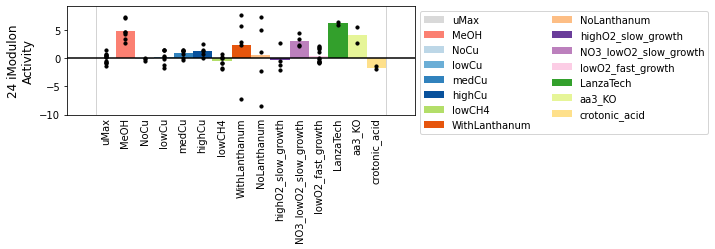

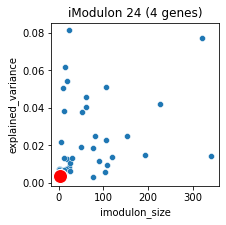

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS02055,0.250698,NaN,432512,434726,1,TonB-dependent receptor,P,Inorganic ion transport and metabolism,NaN,2549,EQU24_RS02055,WP_235726409.1,||None,cell outer membrane\nintegral component of mem...,['cell outer membrane' 'integral component of ...
EQU24_RS15150,0.253293,NaN,3384817,3385819,1,hypothetical protein,X,No COG annotation,A0A4P9UPS4,916,EQU24_RS15150,WP_017838693.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS15155,0.267343,NaN,3386052,3387633,1,DHA2 family efflux MFS transporter permease su...,P,Inorganic ion transport and metabolism,A0A4P9USD2,915,EQU24_RS15165 // EQU24_RS15160 // EQU24_RS15155,WP_017838692.1,||None,plasma membrane\nintegral component of membran...,['plasma membrane' 'integral component of memb...
EQU24_RS15160,0.165093,NaN,3387629,3389084,1,efflux transporter outer membrane subunit,M,Cell wall/membrane/envelope biogenesis,A0A4P9USR8,915,EQU24_RS15165 // EQU24_RS15160 // EQU24_RS15155,WP_017838691.1,||None,amide transport\nnitrogen compound transport\n...,['amide transport' 'nitrogen compound transpor...


In [83]:
imod_info(24)

In [84]:
ica_data.imodulon_table.loc[24,'function'] = 'up-in-MeOH/LanzaTech/ton-B/some-transport_EW'


## iMod 25

iModulon SG_4


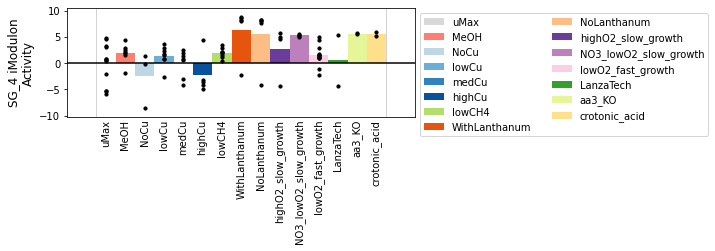

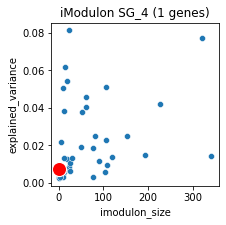

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS11915,0.579356,NaN,2664641,2665580,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,1329,EQU24_RS11915,NaN,||,NaN,[]


In [86]:
imod_info("SG_4")

In [87]:
ica_data.imodulon_table.loc["SG_4",'function'] = 'transposase_EW'


## iMod 26

iModulon 26


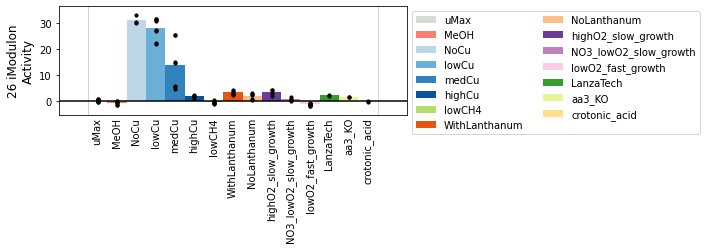

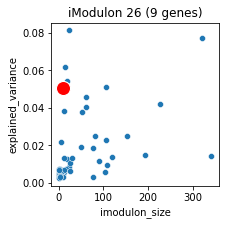

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
144,26,methane metabolic process,2.273876e-15,4.664857e-12,0.666667,0.600000,0.631579,6.0,10.0,9.0,GO,NaN,NaN,NaN
145,26,methane monooxygenase activity,2.273876e-15,4.664857e-12,0.666667,0.600000,0.631579,6.0,10.0,9.0,GO,NaN,NaN,NaN
146,26,methane monooxygenase complex,2.394179e-13,3.274439e-10,0.555556,0.714286,0.625000,5.0,7.0,9.0,GO,NaN,NaN,NaN
25,26,NaN,3.243692e-14,1.102855e-11,0.666667,0.428571,0.521739,6.0,14.0,9.0,KEGG modules,M00174,NaN,"Methane oxidation, methanotroph, methane => fo..."
147,26,cellular alkane metabolic process,5.250514e-12,4.308571e-09,0.555556,0.454545,0.500000,5.0,11.0,9.0,GO,NaN,NaN,NaN
148,26,"oxidoreductase activity, acting on paired dono...",5.250514e-12,4.308571e-09,0.555556,0.454545,0.500000,5.0,11.0,9.0,GO,NaN,NaN,NaN
149,26,monooxygenase activity,8.993743e-12,6.150221e-09,0.555556,0.416667,0.476190,5.0,12.0,9.0,GO,NaN,NaN,NaN
14,26,NaN,2.000284e-13,5.060719e-11,0.666667,0.333333,0.444444,6.0,18.0,9.0,KEGG pathways,map01220,Degradation of aromatic compounds,NaN
150,26,"oxidoreductase activity, acting on paired dono...",3.402018e-11,1.994069e-08,0.555556,0.333333,0.416667,5.0,15.0,9.0,GO,NaN,NaN,NaN
26,26,NaN,1.215885e-05,2.067004e-03,0.222222,0.666667,0.333333,2.0,3.0,9.0,KEGG modules,M00538,NaN,"Toluene degradation, toluene => benzoate"


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS05885,0.288698,mmoX,1283573,1285151,1,methane monooxygenase,H,Coenzyme transport and metabolism,A0A4P9UNN3,2088,EQU24_RS05885,WP_017840379.1,||None,methane monooxygenase activity\nmethane metabo...,['methane monooxygenase activity' 'methane met...
EQU24_RS05890,0.277501,mmoY,1285264,1286443,1,methane monooxygenase,H,Coenzyme transport and metabolism,A0A4P9UKQ6,2087,EQU24_RS05900 // EQU24_RS05895 // EQU24_RS05890,WP_017840378.1,||None,methane monooxygenase activity\nmethane monoox...,['methane monooxygenase activity' 'methane mon...
EQU24_RS05895,0.285164,mmoB,1286453,1286879,1,methane monooxygenase,C,Energy production and conversion,A0A4P9UMZ7,2087,EQU24_RS05900 // EQU24_RS05895 // EQU24_RS05890,WP_017840377.1,||None,methane monooxygenase activity\nmethane monoox...,['methane monooxygenase activity' 'methane mon...
EQU24_RS05900,0.274480,mmoZ,1286888,1287392,1,hypothetical protein,H,Coenzyme transport and metabolism,A0A4P9UKU7,2087,EQU24_RS05900 // EQU24_RS05895 // EQU24_RS05890,WP_017840376.1,||None,methane monooxygenase activity\nmethane metabo...,['methane monooxygenase activity' 'methane met...
EQU24_RS05905,0.246197,mmoD,1287718,1287934,1,soluble methane monooxygenase-binding protein ...,X,No COG annotation,UPI0003479E2D,2086,EQU24_RS05910 // mmoD,WP_201764852.1,mmoD||mmoD,methane monooxygenase activity\nmethane monoox...,['methane monooxygenase activity' 'methane mon...
EQU24_RS05910,0.246274,mmoC,1287957,1288995,1,2Fe-2S iron-sulfur cluster binding domain-cont...,C,Energy production and conversion,A0A4V1IJL6,2086,EQU24_RS05910 // mmoD,WP_017840374.1,||None,methane monooxygenase activity\nchlorosome\nme...,['methane monooxygenase activity' 'chlorosome'...
EQU24_RS05915,0.224486,NaN,1289471,1289897,1,BLUF domain-containing protein,S,Function unknown,NaN,2085,EQU24_RS05915,WP_235726398.1,||None,FAD binding\nblue light signaling pathway\nblu...,['FAD binding' 'blue light signaling pathway'\...
EQU24_RS05920,0.235946,NaN,1290051,1290351,1,hypothetical protein,X,No COG annotation,A0A4P9UL60,2084,EQU24_RS05920,WP_017840372.1,||None,NaN,[]
EQU24_RS05925,0.236003,mmoG,1290558,1292238,1,likely chaperone for smmo,O,"Post-translational modification, protein turno...",A0A4P9UKZ6,2083,EQU24_RS05925,WP_017840371.1,||groEL,ATP binding\nGroEL-GroES complex\nchaperone-me...,['ATP binding' 'GroEL-GroES complex' 'chaperon...


In [88]:
imod_info(26)

In [89]:
ica_data.imodulon_table.loc[26,'category'] = 'functional'
ica_data.imodulon_table.loc[26,'function'] = 'smmo-cluster_EW'


## iMod 27

iModulon 27


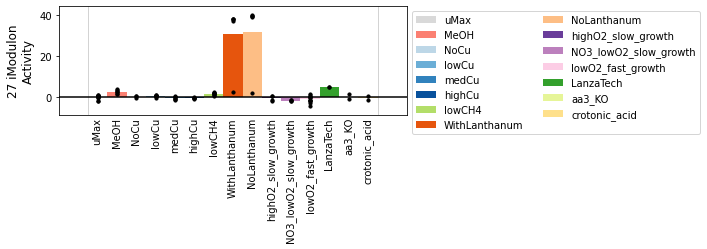

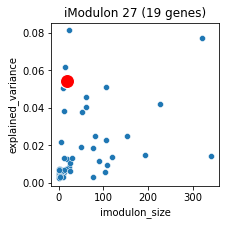

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS01450,0.212431,NaN,301239,302325,-1,DUF4338 domain-containing protein,L,"Replication, recombination and repair",NaN,2631,EQU24_RS01450 // EQU24_RS01445,NaN,||,NaN,[]
EQU24_RS03790,-0.106959,NaN,810562,810636,1,NaN,X,No COG annotation,NaN,2336,nusG // secE // EQU24_RS03805 // tuf // EQU24_...,NaN,||,NaN,[]
EQU24_RS03795,-0.101968,NaN,810653,810729,1,NaN,X,No COG annotation,NaN,2336,nusG // secE // EQU24_RS03805 // tuf // EQU24_...,NaN,||,NaN,[]
EQU24_RS04160,-0.128373,NaN,874502,874683,-1,NaN,X,No COG annotation,NaN,2308,EQU24_RS04170 // EQU24_RS04165 // ssrS // EQU2...,NaN,||,NaN,[]
EQU24_RS05635,-0.136819,NaN,1220732,1220808,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]
EQU24_RS05640,-0.087171,NaN,1220826,1220902,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]
EQU24_RS08850,0.178466,NaN,1962015,1962198,-1,type II toxin-antitoxin system HicA family toxin,N,Cell motility,A0A4P9UNQ6,1710,EQU24_RS08850 // EQU24_RS08845,WP_017839128.1,||None,mRNA binding,['mRNA binding']
EQU24_RS09830,-0.125616,NaN,2185247,2185322,1,NaN,X,No COG annotation,NaN,1582,EQU24_RS09835 // EQU24_RS09830 // EQU24_RS09825,NaN,||,NaN,[]
EQU24_RS09835,-0.108710,NaN,2185369,2185443,1,NaN,X,No COG annotation,NaN,1582,EQU24_RS09835 // EQU24_RS09830 // EQU24_RS09825,NaN,||,NaN,[]


In [90]:
imod_info(27)

In [91]:
ica_data.imodulon_table.loc[27,'function'] = 'transposase/toxin-anti-toxin_EW'


## iMod 28

iModulon 28


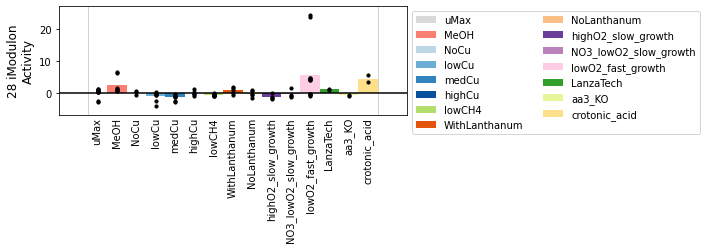

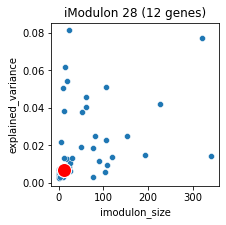

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
27,28,NaN,1.760820e-07,0.00006,0.25,0.6,0.352941,3.0,5.0,12.0,KEGG modules,M00240,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS19155,0.157048,NaN,4282467,4283163,1,DUF2182 domain-containing protein,S,Function unknown,UPI000A2F3717,407,EQU24_RS19155,WP_085986406.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS19160,0.170664,NaN,4283255,4285490,-1,TonB-dependent receptor,P,Inorganic ion transport and metabolism,NaN,406,EQU24_RS19160,WP_017842024.1,||None,cell outer membrane\nintegral component of mem...,['cell outer membrane' 'integral component of ...
EQU24_RS20545,0.172243,NaN,4632179,4633250,-1,iron chelate uptake ABC transporter family per...,P,Inorganic ion transport and metabolism,UPI0003474247,222,EQU24_RS20550 // EQU24_RS20545 // EQU24_RS20540,WP_138767248.1,||None,plasma membrane\nintegral component of membran...,['plasma membrane' 'integral component of memb...
EQU24_RS20550,0.221669,NaN,4633246,4634119,-1,hemin ABC transporter substrate-binding protein,P,Inorganic ion transport and metabolism,A0A4P9US51,222,EQU24_RS20550 // EQU24_RS20545 // EQU24_RS20540,WP_017841761.1,||None,NaN,[]
EQU24_RS20555,0.241414,NaN,4634454,4635003,-1,pyridoxamine 5'-phosphate oxidase,P,Inorganic ion transport and metabolism,A0A4P9UUR5,221,EQU24_RS20555,WP_017841760.1,||None,NaN,['']
EQU24_RS20560,0.247234,NaN,4635443,4636508,-1,hypothetical protein,P,Inorganic ion transport and metabolism,UPI0003470AB8,220,EQU24_RS20565 // EQU24_RS20560,WP_051056252.1,||None,iron ion transport,['iron ion transport']
EQU24_RS20565,0.229190,NaN,4636447,4636726,-1,hypothetical protein,X,No COG annotation,A0A4V1IKB8,220,EQU24_RS20565 // EQU24_RS20560,WP_017841758.1,||None,NaN,[]
EQU24_RS20570,0.177695,NaN,4636915,4637191,1,hypothetical protein,X,No COG annotation,NaN,219,EQU24_RS20570,NaN,||,NaN,[]
EQU24_RS20575,0.261790,NaN,4637283,4639062,-1,hypothetical protein,G,Carbohydrate transport and metabolism,A0A4P9USE5,218,EQU24_RS20575,WP_017841756.1,||None,protein binding\nmembrane,['protein binding' 'membrane']


In [92]:
imod_info(28)

In [93]:
ica_data.imodulon_table.loc[28,'function'] = 'ion-transport/outlier-repsonse-FM11_EW'


## iMod 29

iModulon 29


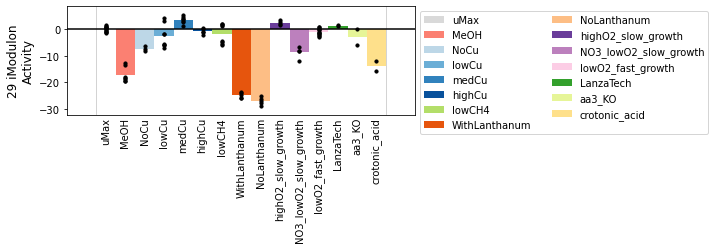

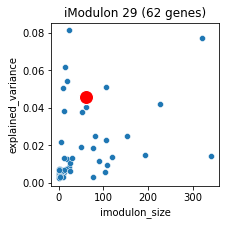

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
20,29,NaN,4.315480e-09,0.000001,0.145161,0.219512,0.174757,9.0,41.0,62.0,KEGG pathways,map00910,Nitrogen metabolism,NaN
154,29,nitrogen fixation,5.817899e-06,0.023871,0.080645,0.263158,0.123457,5.0,19.0,62.0,GO,NaN,NaN,NaN
28,29,NaN,3.036741e-06,0.001032,0.048387,1.000000,0.092308,3.0,3.0,62.0,KEGG modules,M00438,NaN,NaN
29,29,NaN,5.884075e-05,0.010003,0.048387,0.500000,0.088235,3.0,6.0,62.0,KEGG modules,M00530,NaN,"Dissimilatory nitrate reduction, nitrate => am..."
21,29,NaN,6.333123e-04,0.080114,0.032258,0.666667,0.061538,2.0,3.0,62.0,KEGG pathways,map00791,Atrazine degradation,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00940,-0.072191,NaN,193739,193970,1,hypothetical protein,X,No COG annotation,A0A4P9UIM7,2704,EQU24_RS00940,WP_017841310.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS01305,-0.072599,NaN,265994,267545,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2653,EQU24_RS01305,WP_244310896.1,||None,NaN,[]
EQU24_RS02055,-0.070473,NaN,432512,434726,1,TonB-dependent receptor,P,Inorganic ion transport and metabolism,NaN,2549,EQU24_RS02055,WP_235726409.1,||None,cell outer membrane\nintegral component of mem...,['cell outer membrane' 'integral component of ...
EQU24_RS02555,0.129413,NaN,543573,545553,1,hypothetical protein,N,Cell motility,NaN,2479,EQU24_RS02555,WP_017841004.1,||None,NaN,[]
EQU24_RS03400,0.065638,NaN,721431,721647,-1,hypothetical protein,X,No COG annotation,NaN,2384,EQU24_RS03405 // EQU24_RS03400,NaN,||,integral component of membrane,['integral component of membrane']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS17160,0.065969,NaN,3852329,3852761,-1,nitrogen fixation protein NifX,S,Function unknown,UPI00034A3FAE,657,EQU24_RS17160,WP_017842396.1,||None,nitrogen fixation\nmetal cluster binding\n,['nitrogen fixation' 'metal cluster binding' '']
EQU24_RS17270,0.065009,nifL,3872605,3874195,1,nitrogen fixation negative regulator NifL,K,Transcription,NaN,643,nifA // nifL,WP_235726433.1,nifL||nifL,peptidyl-histidine phosphorylation\nATP bindin...,['peptidyl-histidine phosphorylation' 'ATP bin...
EQU24_RS17275,0.056701,nifA,3874198,3875725,1,nif-specific transcriptional activator NifA,K,Transcription,A0A4P9UQS6,643,nifA // nifL,WP_017842373.1,nifA||nifA,"regulation of transcription, DNA-templated\nse...","['regulation of transcription, DNA-templated'\..."


In [94]:
imod_info(29)

In [95]:
ica_data.imodulon_table.loc[29,'function'] = 'nitrogen-related-transport_EW'


## iMod 30

iModulon 30


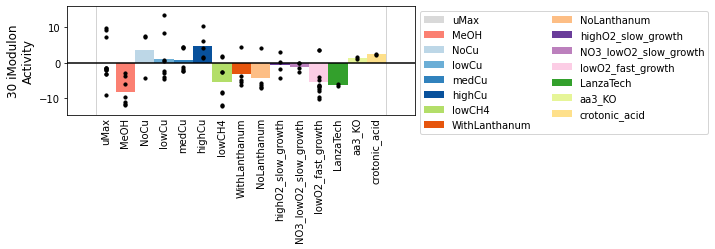

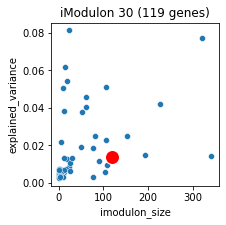

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00110,0.038757,NaN,25137,25554,1,OsmC family protein,O,"Post-translational modification, protein turno...",A0A4V1IJB6,2817,speD // EQU24_RS00110,WP_017841455.1,||None,NaN,[]
EQU24_RS00165,0.053241,NaN,36832,37129,-1,hypothetical protein,X,No COG annotation,A0A4V1IJB7,2810,EQU24_RS00165,WP_017841444.1,||None,NaN,[]
EQU24_RS00175,0.044140,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00390,0.047177,NaN,82907,83930,1,glycosyltransferase family 4 protein,M,Cell wall/membrane/envelope biogenesis,UPI000344E98D,2777,EQU24_RS00390,WP_017841409.1,||None,phospho-N-acetylmuramoyl-pentapeptide-transfer...,['phospho-N-acetylmuramoyl-pentapeptide-transf...
EQU24_RS00450,0.046040,NaN,95639,95957,1,phosphoribosyl-ATP diphosphatase,E,Amino acid transport and metabolism,A0A4P9UN41,2770,EQU24_RS00450 // hisI // hisF // hisA // hisH ...,WP_017841397.1,||None,phosphoribosyl-ATP diphosphatase activity\ncar...,['phosphoribosyl-ATP diphosphatase activity'\n...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS20950,0.047680,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]
EQU24_RS21815,0.057939,NaN,4920552,4921551,1,hypothetical protein,X,No COG annotation,A0A4P9USR1,43,EQU24_RS21830 // EQU24_RS21825 // EQU24_RS2182...,WP_017841539.1,||None,NaN,[]
EQU24_RS21835,-0.051703,NaN,4924469,4925954,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI00034C438D,42,EQU24_RS21835,WP_017841535.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [96]:
imod_info(30)

In [97]:
ica_data.imodulon_table.loc[30,'function'] = 'medium-unclear_EW'


## iMod 31

iModulon 31


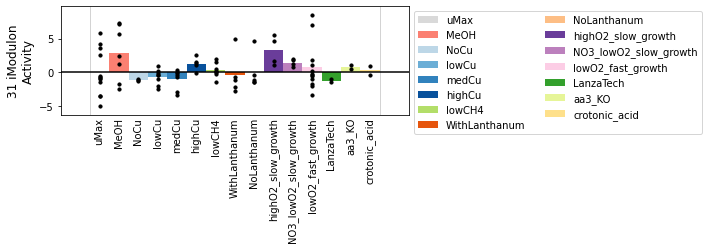

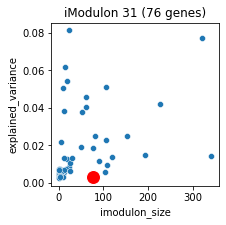

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
155,31,ornithine cyclodeaminase activity,0.000022,0.091436,0.039474,0.75,0.075,3.0,4.0,76.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00055,0.052337,NaN,13298,13604,1,DUF3240 domain-containing protein,S,Function unknown,A0A4V1IJB5,2825,EQU24_RS00055 // EQU24_RS00050 // EQU24_RS0004...,WP_014146532.1,||None,NaN,[]
EQU24_RS00075,-0.157486,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00205,-0.059474,NaN,44526,46077,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2803,EQU24_RS00205,WP_244310896.1,||None,NaN,[]
EQU24_RS00780,0.087506,NaN,161810,161999,1,hypothetical protein,X,No COG annotation,NaN,2724,EQU24_RS00780,NaN,||,integral component of membrane\nmembrane,['integral component of membrane' 'membrane']
EQU24_RS01155,0.050853,NaN,234648,234873,1,hypothetical protein,X,No COG annotation,UPI0009FE04B7,2670,EQU24_RS01155,WP_083877732.1,||None,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS20500,0.051042,NaN,4625665,4625851,-1,hypothetical protein,X,No COG annotation,NaN,228,EQU24_RS20500,NaN,||,NaN,[]
EQU24_RS20650,0.146031,NaN,4658178,4658265,1,NaN,X,No COG annotation,NaN,207,EQU24_RS20650,NaN,||,NaN,[]
EQU24_RS20980,-0.071481,NaN,4722789,4723914,-1,ISAs1 family transposase,L,"Replication, recombination and repair",A0A4P9USK5,155,EQU24_RS20980,WP_014149870.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [98]:
imod_info(31)

In [99]:
ica_data.imodulon_table.loc[31,'function'] = 'ornithine-cyclodeaminase-activity?_EW'


## iMod 32

iModulon 32


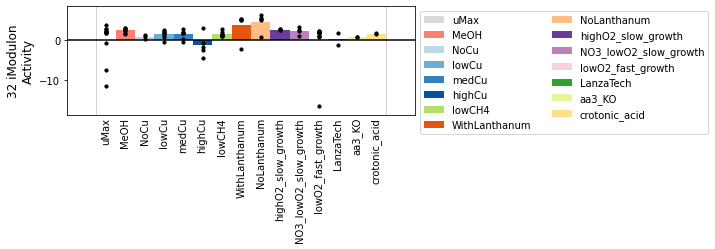

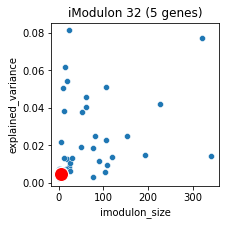

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00175,0.197143,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS07995,-0.177069,NaN,1765410,1766609,-1,IS3 family transposase,L,"Replication, recombination and repair",UPI00110CA4C7,1825,EQU24_RS07995,WP_138767126.1,||None,DNA integration\nsequence-specific DNA binding...,['DNA integration' 'sequence-specific DNA bind...
EQU24_RS18585,0.330915,NaN,4149200,4149536,1,hypothetical protein,L,"Replication, recombination and repair",NaN,484,EQU24_RS18590 // EQU24_RS18585,NaN,||,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS20510,0.456633,NaN,4626446,4626638,-1,hypothetical protein,X,No COG annotation,NaN,227,EQU24_RS20510 // EQU24_RS20505,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS20765,0.339813,NaN,4677500,4678028,-1,phosphatase PAP2 family protein,I,Lipid transport and metabolism,A0A4P9US91,191,EQU24_RS20765 // EQU24_RS20760,WP_017841722.1,||None,integral component of membrane,['integral component of membrane']


In [100]:
imod_info(32)

In [101]:
ica_data.imodulon_table.loc[32,'function'] = 'small_unclear_EW'


## iMod 33

iModulon 33


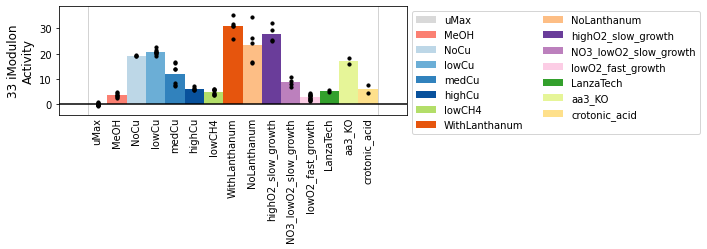

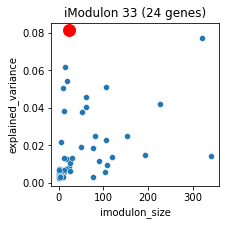

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
22,33,NaN,3.655000e-22,9.247149e-20,0.666667,0.175824,0.278261,16.0,91.0,24.0,KEGG pathways,map02030,Bacterial chemotaxis,NaN
156,33,chemotaxis,2.980065e-14,1.222721e-10,0.416667,0.204082,0.273973,10.0,49.0,24.0,GO,NaN,NaN,NaN
30,33,NaN,8.283873e-11,2.816517e-08,0.333333,0.170213,0.225352,8.0,47.0,24.0,KEGG modules,M00506,NaN,NaN
159,33,transmembrane signaling receptor activity,4.477024e-05,4.592307e-02,0.125000,0.230769,0.162162,3.0,13.0,24.0,GO,NaN,NaN,NaN
157,33,signal transduction,1.349507e-09,2.768514e-06,0.375000,0.091837,0.147541,9.0,102.0,24.0,GO,NaN,NaN,NaN
23,33,NaN,6.761206e-16,8.552925e-14,0.666667,0.074074,0.133333,16.0,216.0,24.0,KEGG pathways,map02020,Two-component system,NaN
158,33,phosphorelay signal transduction system,1.111983e-07,1.520822e-04,0.375000,0.055901,0.097297,9.0,161.0,24.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS10515,0.109474,NaN,2336585,2336855,-1,hypothetical protein,X,No COG annotation,A0A4P9UMW8,1502,EQU24_RS10515,WP_014148531.1,||None,NaN,[]
EQU24_RS10520,0.146413,NaN,2336917,2337478,-1,chemotaxis protein CheW,N,Cell motility,A0A4P9UMQ2,1501,EQU24_RS10525 // EQU24_RS10520,WP_017839547.1,||None,chemotaxis\nsignal transduction,['chemotaxis' 'signal transduction']
EQU24_RS10525,0.129106,NaN,2337487,2340502,-1,methyl-accepting chemotaxis protein,T,Signal transduction mechanisms,UPI00034979B9,1501,EQU24_RS10525 // EQU24_RS10520,WP_083877624.1,||None,transmembrane signaling receptor activity\nche...,['transmembrane signaling receptor activity' '...
EQU24_RS10530,0.174343,NaN,2340582,2342751,-1,chemotaxis protein CheA,N,Cell motility,A0A4P9UQR2,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839545.1,||None,peptidyl-histidine phosphorylation\nATP bindin...,['peptidyl-histidine phosphorylation' 'ATP bin...
EQU24_RS10535,0.173574,NaN,2342747,2343071,-1,STAS domain-containing protein,T,Signal transduction mechanisms,A0A4P9UMQ8,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839544.1,||None,NaN,[]
EQU24_RS10540,0.156462,NaN,2343082,2343451,-1,response regulator,T,Signal transduction mechanisms,A0A4P9UPZ1,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839543.1,||None,DNA binding\nphosphorelay signal transduction ...,['DNA binding' 'phosphorelay signal transducti...
EQU24_RS10545,0.163522,NaN,2343463,2344675,-1,hypothetical protein,N,Cell motility,NaN,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,NaN,||,transmembrane signaling receptor activity\nche...,['transmembrane signaling receptor activity' '...
EQU24_RS10550,0.116113,NaN,2345682,2347200,1,PAS domain S-box protein,X,No COG annotation,UPI00034D16FC,1499,EQU24_RS10550,WP_186005676.1,||None,phosphorelay signal transduction system\nprote...,['phosphorelay signal transduction system' 'pr...
EQU24_RS10565,0.087981,NaN,2351540,2352749,-1,response regulator,T,Signal transduction mechanisms,A0A4P9UMX4,1496,EQU24_RS10565,WP_017839538.1,||None,phosphorelay signal transduction system\nnucle...,['phosphorelay signal transduction system' 'nu...


In [102]:
imod_info(33)

In [103]:
ica_data.imodulon_table.loc[33,'function'] = 'chemotaxis/signal-transduction/highest-exp-var_EW'


## iMod 34

iModulon 34


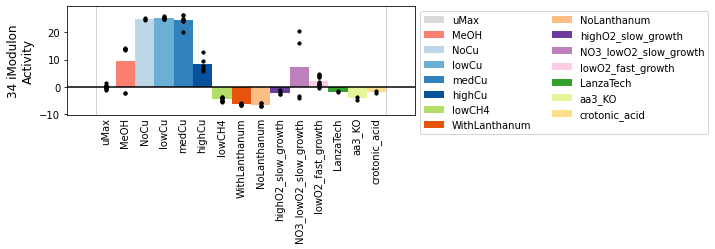

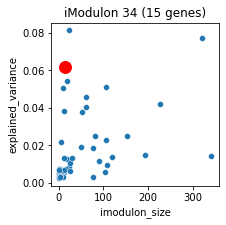

alt.Chart(...)

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
31,34,NaN,0.000047,0.015896,0.2,0.142857,0.166667,3.0,21.0,15.0,KEGG modules,M00331,NaN,NaN
25,34,NaN,0.000574,0.086839,0.2,0.062500,0.095238,3.0,48.0,15.0,KEGG pathways,map05111,Biofilm formation - Vibrio cholerae,NaN
24,34,NaN,0.000686,0.086839,0.2,0.058824,0.090909,3.0,51.0,15.0,KEGG pathways,map03070,Bacterial secretion system,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
locus_tag,,,,,,,,,,,,,,,
EQU24_RS00940,0.171681,NaN,193739,193970,1,hypothetical protein,X,No COG annotation,A0A4P9UIM7,2704,EQU24_RS00940,WP_017841310.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS07675,0.158668,NaN,1687716,1689852,-1,conjugation transfer protein,C,Energy production and conversion,NaN,1863,EQU24_RS07675,NaN,||,heme binding\nelectron transport chain\nmetal ...,['heme binding' 'electron transport chain' 'me...
EQU24_RS07680,0.171277,NaN,1690300,1691008,-1,hypothetical protein,X,No COG annotation,A0A4P9UR71,1862,EQU24_RS07680,WP_017840047.1,||corA,metal ion binding,['metal ion binding']
EQU24_RS19470,0.156487,NaN,4363642,4366327,-1,S8 family serine peptidase,Q,"Secondary metabolites biosynthesis, transport,...",UPI001586656B,363,EQU24_RS19470 // EQU24_RS19465,WP_175421707.1,||None,polysaccharide catabolic process\nserine-type ...,['polysaccharide catabolic process' 'serine-ty...
EQU24_RS19475,0.175449,NaN,4366809,4368060,-1,hypothetical protein,X,No COG annotation,UPI00110D1B61,362,EQU24_RS19480 // EQU24_RS19475,WP_138767233.1,||None,aspartic-type endopeptidase activity\nproteolysis,['aspartic-type endopeptidase activity' 'prote...
EQU24_RS19480,0.190109,NaN,4368064,4370446,-1,DUF3438 family protein,N,Cell motility,A0A4P9UU80,362,EQU24_RS19480 // EQU24_RS19475,WP_017841958.1,||None,protein secretion,['protein secretion']
EQU24_RS19485,0.204531,NaN,4371273,4371714,-1,hypothetical protein,X,No COG annotation,A0A4P9URP9,361,EQU24_RS19490 // EQU24_RS19485,WP_017841955.1,||None,NaN,[]
EQU24_RS19490,0.200805,NaN,4371734,4372952,-1,type II secretion system F family protein,U,"Intracellular trafficking, secretion, and vesi...",A0A4V1IKA0,361,EQU24_RS19490 // EQU24_RS19485,WP_017841954.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS19495,0.207207,NaN,4373252,4375061,-1,hypothetical protein,N,Cell motility,A0A4P9UWM5,360,EQU24_RS19495,WP_017841953.1,||tadA,cyclic-di-GMP binding,['cyclic-di-GMP binding']


In [104]:
imod_info(34)

In [105]:
ica_data.imodulon_table.loc[34,'category'] = 'functional'
ica_data.imodulon_table.loc[34,'function'] = 'cu-repression/secretion/alexey-gene-cluster_EW'


## iMod 35

iModulon 35


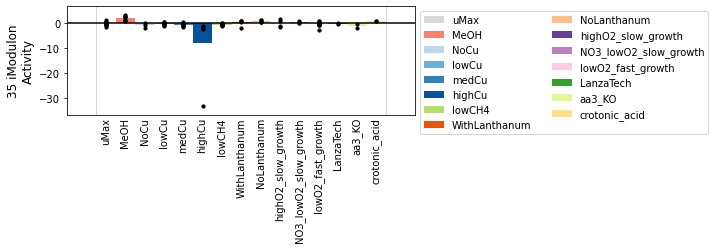

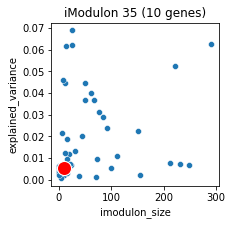

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS03455,0.173204,NaN,734828,735008,-1,hypothetical protein,X,No COG annotation,NaN,2375,EQU24_RS03455,NaN,||,NaN,[]
EQU24_RS05420,0.290447,NaN,1163549,1163954,1,biopolymer transporter ExbD,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UMI9,2154,EQU24_RS05430 // EQU24_RS05425 // EQU24_RS05420,WP_014149416.1,||None,protein transport\nplasma membrane\nintegral c...,['protein transport' 'plasma membrane' 'integr...
EQU24_RS09095,0.238490,NaN,2011099,2011279,-1,hypothetical protein,X,No COG annotation,NaN,1680,EQU24_RS09095 // EQU24_RS09090 // EQU24_RS09085,NaN,||,peptidyl-histidine phosphorylation\nATP bindin...,['peptidyl-histidine phosphorylation' 'ATP bin...
EQU24_RS10680,0.149084,NaN,2374756,2375617,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI0015862106,1488,EQU24_RS10685 // EQU24_RS10680,WP_175421679.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS14480,0.306346,NaN,3237002,3237146,-1,DUF3096 domain-containing protein,S,Function unknown,UPI00022CF931,1014,EQU24_RS14480,WP_014148969.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS14930,0.129914,NaN,3328929,3329181,-1,hypothetical protein,X,No COG annotation,NaN,947,EQU24_RS14930,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS16375,0.253470,NaN,3677719,3678100,-1,hypothetical protein,X,No COG annotation,UPI00110CDF10,754,EQU24_RS16375,WP_138767202.1,||None,NaN,[]
EQU24_RS20320,0.288351,NaN,4585274,4585535,-1,DUF2442 domain-containing protein,S,Function unknown,A0A4P9UV61,252,EQU24_RS20320,WP_017841802.1,||None,NaN,[]
EQU24_RS20610,0.161263,NaN,4646544,4647282,-1,ISAs1 family transposase,L,"Replication, recombination and repair",NaN,212,EQU24_RS20615 // EQU24_RS20610,NaN,||,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS21260,0.214838,NaN,4791094,4791280,1,hypothetical protein,X,No COG annotation,NaN,120,EQU24_RS21260,NaN,||,NaN,[]


In [100]:
imod_info(35)

In [105]:
ica_data.imodulon_table.loc[35,'function'] = 'some-membrane/outlier-response-highCu_T6_EW'


## iMod 36

iModulon 36


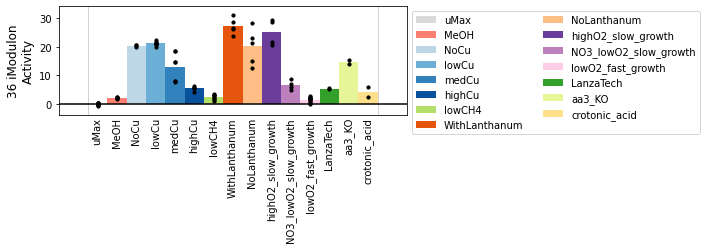

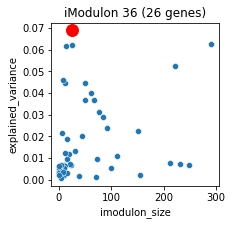

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
33,36,NaN,2.551553e-21,6.455428e-19,0.615385,0.175824,0.273504,16.0,91.0,26.0,KEGG pathways,map02030,Bacterial chemotaxis,NaN
140,36,chemotaxis,7.935131e-14,3.255784e-10,0.384615,0.204082,0.266667,10.0,49.0,26.0,GO,NaN,NaN,NaN
40,36,NaN,1.730701e-10,5.884382e-08,0.307692,0.170213,0.219178,8.0,47.0,26.0,KEGG modules,M00506,NaN,NaN
143,36,transmembrane signaling receptor activity,5.730614e-05,5.878178e-02,0.115385,0.230769,0.153846,3.0,13.0,26.0,GO,NaN,NaN,NaN
141,36,signal transduction,3.103179e-09,6.366171e-06,0.346154,0.091837,0.145161,9.0,102.0,26.0,GO,NaN,NaN,NaN
34,36,NaN,4.454696e-15,5.635190e-13,0.615385,0.074074,0.132231,16.0,216.0,26.0,KEGG pathways,map02020,Two-component system,NaN
142,36,phosphorelay signal transduction system,2.487547e-07,3.402135e-04,0.346154,0.055901,0.096257,9.0,161.0,26.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS10515,0.134049,NaN,2336585,2336855,-1,hypothetical protein,X,No COG annotation,A0A4P9UMW8,1502,EQU24_RS10515,WP_014148531.1,||None,NaN,[]
EQU24_RS10520,0.157371,NaN,2336917,2337478,-1,chemotaxis protein CheW,N,Cell motility,A0A4P9UMQ2,1501,EQU24_RS10525 // EQU24_RS10520,WP_017839547.1,||None,chemotaxis\nsignal transduction,['chemotaxis' 'signal transduction']
EQU24_RS10525,0.139085,NaN,2337487,2340502,-1,methyl-accepting chemotaxis protein,T,Signal transduction mechanisms,UPI00034979B9,1501,EQU24_RS10525 // EQU24_RS10520,WP_083877624.1,||None,transmembrane signaling receptor activity\nche...,['transmembrane signaling receptor activity' '...
EQU24_RS10530,0.193176,NaN,2340582,2342751,-1,chemotaxis protein CheA,N,Cell motility,A0A4P9UQR2,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839545.1,||None,peptidyl-histidine phosphorylation\nATP bindin...,['peptidyl-histidine phosphorylation' 'ATP bin...
EQU24_RS10535,0.199150,NaN,2342747,2343071,-1,STAS domain-containing protein,T,Signal transduction mechanisms,A0A4P9UMQ8,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839544.1,||None,NaN,[]
EQU24_RS10540,0.176073,NaN,2343082,2343451,-1,response regulator,T,Signal transduction mechanisms,A0A4P9UPZ1,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,WP_017839543.1,||None,DNA binding\nphosphorelay signal transduction ...,['DNA binding' 'phosphorelay signal transducti...
EQU24_RS10545,0.173408,NaN,2343463,2344675,-1,hypothetical protein,N,Cell motility,NaN,1500,EQU24_RS10545 // EQU24_RS10540 // EQU24_RS1053...,NaN,||,transmembrane signaling receptor activity\nche...,['transmembrane signaling receptor activity' '...
EQU24_RS10550,0.139188,NaN,2345682,2347200,1,PAS domain S-box protein,X,No COG annotation,UPI00034D16FC,1499,EQU24_RS10550,WP_186005676.1,||None,phosphorelay signal transduction system\nprote...,['phosphorelay signal transduction system' 'pr...
EQU24_RS10565,0.092290,NaN,2351540,2352749,-1,response regulator,T,Signal transduction mechanisms,A0A4P9UMX4,1496,EQU24_RS10565,WP_017839538.1,||None,phosphorelay signal transduction system\nnucle...,['phosphorelay signal transduction system' 'nu...
EQU24_RS10575,0.096598,NaN,2355155,2356262,-1,chemotaxis response regulator protein-glutamat...,N,Cell motility,A0A4P9UQ06,1495,EQU24_RS10575 // EQU24_RS10570,WP_026130029.1,||None,protein deamination\nprotein-glutamine glutami...,['protein deamination' 'protein-glutamine glut...


In [102]:
imod_info(36)

In [104]:
ica_data.imodulon_table.loc[36,'category'] = 'functional'
ica_data.imodulon_table.loc[36,'function'] = 'chemotaxis/signal-transduction/highest-exp-var_EW'

## iMod 37

iModulon SG_4


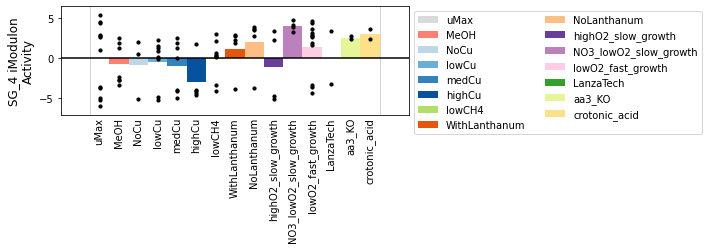

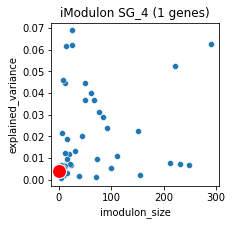

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS11910,0.789798,NaN,2663997,2664351,1,hypothetical protein,X,No COG annotation,NaN,1330,EQU24_RS11910,NaN,||,NaN,[]


In [107]:
imod_info("SG_4")

In [108]:
ica_data.imodulon_table.loc["SG_4",'function'] = 'hypothetical-prot_EW'

## iMod 38

iModulon SG_5


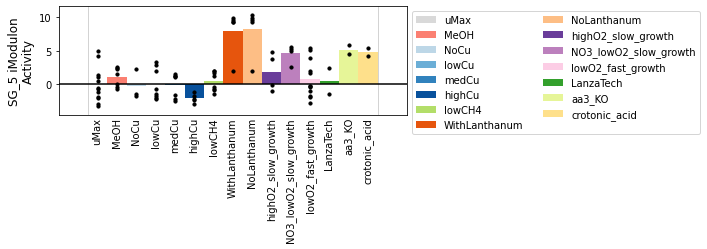

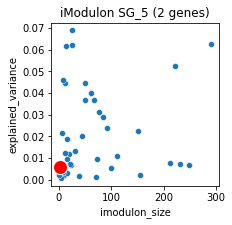

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS16560,0.617031,NaN,3715697,3717248,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,727,EQU24_RS16560,WP_040575330.1,||None,NaN,[]
EQU24_RS20950,0.292919,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]


In [110]:
imod_info("SG_5")

In [111]:
ica_data.imodulon_table.loc["SG_5",'function'] = 'transposase_EW'

## iMod 39

iModulon 39


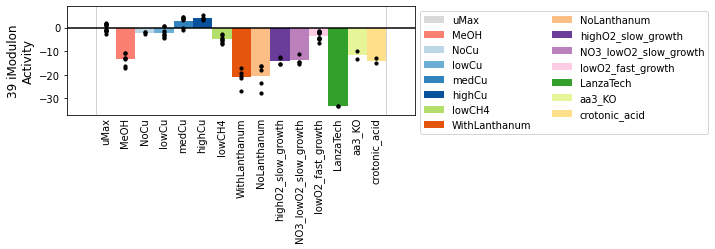

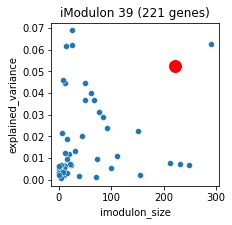

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
151,39,cellular nitrogen compound biosynthetic process,8.683386e-08,0.000045,0.167421,0.131673,0.147410,37.0,281.0,221.0,GO,NaN,NaN,NaN
158,39,organonitrogen compound biosynthetic process,5.445130e-07,0.000149,0.176471,0.119266,0.142336,39.0,327.0,221.0,GO,NaN,NaN,NaN
148,39,amide biosynthetic process,2.236416e-08,0.000018,0.108597,0.188976,0.137931,24.0,127.0,221.0,GO,NaN,NaN,NaN
165,39,organic substance biosynthetic process,3.525025e-06,0.000743,0.212670,0.101732,0.137628,47.0,462.0,221.0,GO,NaN,NaN,NaN
164,39,biosynthetic process,3.696737e-06,0.000743,0.217195,0.100629,0.137536,48.0,477.0,221.0,GO,NaN,NaN,NaN
163,39,cellular biosynthetic process,3.984428e-06,0.000743,0.212670,0.101293,0.137226,47.0,464.0,221.0,GO,NaN,NaN,NaN
169,39,cytosol,1.204061e-05,0.001972,0.221719,0.095703,0.133697,49.0,512.0,221.0,GO,NaN,NaN,NaN
154,39,cellular amide metabolic process,1.376658e-07,0.000051,0.108597,0.172662,0.133333,24.0,139.0,221.0,GO,NaN,NaN,NaN
144,39,peptide biosynthetic process,1.463567e-08,0.000015,0.095023,0.216495,0.132075,21.0,97.0,221.0,GO,NaN,NaN,NaN
172,39,cytoplasm,4.046277e-05,0.005725,0.276018,0.084722,0.129649,61.0,720.0,221.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00075,0.046559,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00105,0.058910,crp,24340,24994,-1,cAMP-activated global transcriptional regulato...,K,Transcription,A0A4P9UID5,2818,crp // EQU24_RS00100,WP_014146545.1,crp||crp,negative regulation of nucleic acid-templated ...,['negative regulation of nucleic acid-template...
EQU24_RS00110,0.067191,NaN,25137,25554,1,OsmC family protein,O,"Post-translational modification, protein turno...",A0A4V1IJB6,2817,speD // EQU24_RS00110,WP_017841455.1,||None,NaN,[]
EQU24_RS00505,0.050959,rpsU,104077,104311,1,30S ribosomal protein S21,J,"Translation, ribosomal structure and biogenesis",A0A4P9UIV9,2762,EQU24_RS00510 // rpsU,WP_014146611.1,rpsU||rpsU,ribosomal small subunit assembly\nribosome ass...,['ribosomal small subunit assembly' 'ribosome ...
EQU24_RS00510,0.045898,NaN,104333,104783,1,GatB/YqeY domain-containing protein,S,Function unknown,A0A4P9UIP9,2762,EQU24_RS00510 // rpsU,WP_017841386.1,||None,"carbon-nitrogen ligase activity, with glutamin...","['carbon-nitrogen ligase activity, with glutam..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21645,-0.053832,NaN,4886529,4886943,-1,hypothetical protein,X,No COG annotation,UPI00034CBEF0,65,EQU24_RS21645,WP_138767255.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS21950,-0.048036,NaN,4951896,4953342,1,sigma-70 family RNA polymerase sigma factor,K,Transcription,UPI00034C420F,26,EQU24_RS21950,WP_175421718.1,||None,"regulation of DNA-templated transcription, ini...","['regulation of DNA-templated transcription, i..."
EQU24_RS21955,-0.035232,hflK,4953432,4954593,1,FtsH protease activity modulator HflK,O,"Post-translational modification, protein turno...",A0A4P9USU2,25,hflB // hflC // hflK,WP_017841512.1,hflK||hflK,integral component of external side of plasma ...,['integral component of external side of plasm...
EQU24_RS22045,-0.036226,NaN,4978984,4979710,1,cyclic nucleotide-binding domain-containing pr...,K,Transcription,NaN,13,EQU24_RS22045,WP_235726419.1,||None,"regulation of transcription, DNA-templated\nDN...","['regulation of transcription, DNA-templated' ..."


In [112]:
imod_info(39)

In [114]:
ica_data.imodulon_table.loc[39,'category'] = 'functional'
ica_data.imodulon_table.loc[39,'function'] = 'translation/ribosomal/biosynthesis_EW'

## iMod 40

iModulon SG_6


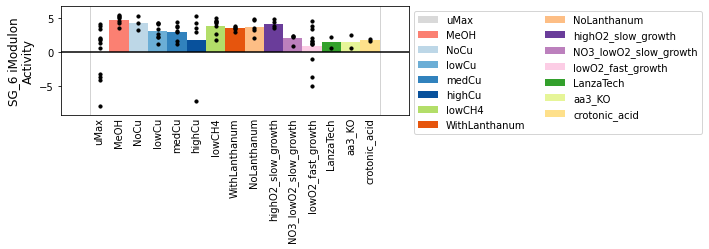

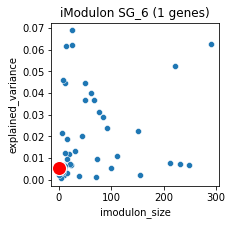

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS08710,0.608356,NaN,1931194,1931374,1,hypothetical protein,X,No COG annotation,NaN,1728,EQU24_RS08720 // EQU24_RS08715 // EQU24_RS08710,NaN,||,NaN,[]


In [116]:
imod_info('SG_6')

In [117]:
ica_data.imodulon_table.loc["SG_6",'function'] = 'hypothetical-prot_EW'

## iMod 41

iModulon 41


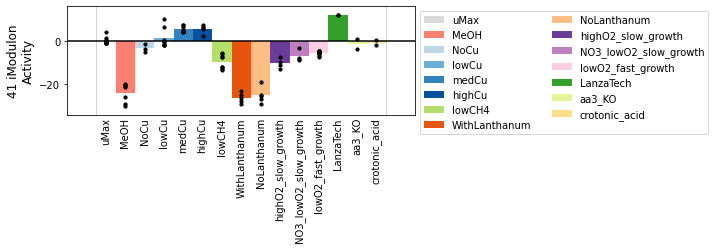

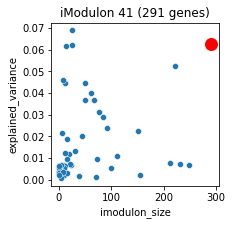

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
192,41,translation,3.596113e-34,1.475485e-30,0.178694,0.500000,0.263291,52.0,104.0,291.0,GO,NaN,NaN,NaN
204,41,cellular nitrogen compound biosynthetic process,1.456725e-26,4.597649e-24,0.254296,0.263345,0.258741,74.0,281.0,291.0,GO,NaN,NaN,NaN
199,41,amide biosynthetic process,8.841671e-29,4.149410e-26,0.178694,0.409449,0.248804,52.0,127.0,291.0,GO,NaN,NaN,NaN
196,41,peptide biosynthetic process,2.924840e-31,2.400124e-28,0.164948,0.494845,0.247423,48.0,97.0,291.0,GO,NaN,NaN,NaN
202,41,cellular amide metabolic process,1.666308e-27,6.215330e-25,0.182131,0.381295,0.246512,53.0,139.0,291.0,GO,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
425,41,polysome,4.755664e-03,8.130204e-02,0.006873,1.000000,0.013652,2.0,2.0,291.0,GO,NaN,NaN,NaN
424,41,polysomal ribosome,4.755664e-03,8.130204e-02,0.006873,1.000000,0.013652,2.0,2.0,291.0,GO,NaN,NaN,NaN
423,41,DNA-directed RNA polymerase complex,4.755664e-03,8.130204e-02,0.006873,1.000000,0.013652,2.0,2.0,291.0,GO,NaN,NaN,NaN
419,41,S-adenosylmethionine metabolic process,4.755664e-03,8.130204e-02,0.006873,1.000000,0.013652,2.0,2.0,291.0,GO,NaN,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00020,0.027063,gyrB,4185,6600,1,DNA topoisomerase (ATP-hydrolyzing) subunit B,L,"Replication, recombination and repair",A0A4P9UI83,2828,gyrB,WP_017841469.1,gyrB||gyrB,ATP hydrolysis activity\nATP hydrolysis activi...,['ATP hydrolysis activity' 'ATP hydrolysis act...
EQU24_RS00045,0.028321,NaN,9071,10241,1,efflux RND transporter periplasmic adaptor sub...,M,Cell wall/membrane/envelope biogenesis,A0A4P9UKH1,2825,EQU24_RS00055 // EQU24_RS00050 // EQU24_RS0004...,WP_017841466.1,||None,transmembrane transporter activity\ntransmembr...,['transmembrane transporter activity' 'transme...
EQU24_RS00175,0.029686,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00205,0.031454,NaN,44526,46077,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2803,EQU24_RS00205,WP_244310896.1,||None,NaN,[]
EQU24_RS00240,-0.035278,NaN,49350,49572,1,hypothetical protein,X,No COG annotation,NaN,2798,EQU24_RS00240,NaN,||,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21815,0.032004,NaN,4920552,4921551,1,hypothetical protein,X,No COG annotation,A0A4P9USR1,43,EQU24_RS21830 // EQU24_RS21825 // EQU24_RS2182...,WP_017841539.1,||None,NaN,[]
EQU24_RS21820,0.047353,NaN,4921568,4921862,1,hypothetical protein,X,No COG annotation,A0A4P9USQ6,43,EQU24_RS21830 // EQU24_RS21825 // EQU24_RS2182...,WP_017841538.1,||None,NaN,[]
EQU24_RS21825,0.035101,NaN,4921876,4922530,1,HNH endonuclease,V,Defense mechanisms,A0A4P9UV06,43,EQU24_RS21830 // EQU24_RS21825 // EQU24_RS2182...,WP_017841537.1,||None,endonuclease activity\nnucleic acid phosphodie...,['endonuclease activity' 'nucleic acid phospho...
EQU24_RS21970,0.030547,NaN,4957466,4957907,1,hypothetical protein,X,No COG annotation,A0A4P9UT06,24,EQU24_RS21970,WP_017841509.1,||None,integral component of membrane,['integral component of membrane']


In [118]:
imod_info(41)

In [119]:
ica_data.imodulon_table.loc[41,'function'] = 'translation/ribosomal/biosynthesis_EW'

## iMod 42

iModulon 42


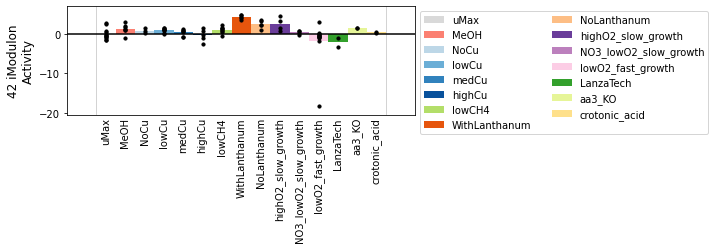

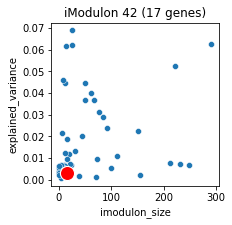

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00175,-0.112651,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS01385,0.148525,lexA,287898,288525,1,transcriptional repressor LexA,K,Transcription,A0A4P9UIS2,309,lexA,WP_017841220.1,lexA||lexA,positive regulation of nucleic acid-templated ...,['positive regulation of nucleic acid-template...
EQU24_RS01760,0.132330,cydX,371326,371470,1,cytochrome bd-I oxidase subunit CydX,S,Function unknown,UPI0003472C68,2591,cydX,WP_017841155.1,cydX||cydX,integral component of plasma membrane\nouter m...,['integral component of plasma membrane' 'oute...
EQU24_RS07995,-0.133022,NaN,1765410,1766609,-1,IS3 family transposase,L,"Replication, recombination and repair",UPI00110CA4C7,1825,EQU24_RS07995,WP_138767126.1,||None,DNA integration\nsequence-specific DNA binding...,['DNA integration' 'sequence-specific DNA bind...
EQU24_RS08710,0.081821,NaN,1931194,1931374,1,hypothetical protein,X,No COG annotation,NaN,1728,EQU24_RS08720 // EQU24_RS08715 // EQU24_RS08710,NaN,||,NaN,[]
EQU24_RS10630,0.093460,NaN,2363383,2363632,-1,hypothetical protein,X,No COG annotation,A0A4P9UQ17,1492,EQU24_RS10650 // EQU24_RS10645 // EQU24_RS1064...,WP_017839525.1,||None,biological_process\ncellular_component\nmolecu...,['biological_process' 'cellular_component' 'mo...
EQU24_RS10960,0.346635,NaN,2446125,2446314,-1,hypothetical protein,X,No COG annotation,A0A4P9UNA8,1458,EQU24_RS10970 // EQU24_RS10965 // EQU24_RS1096...,WP_017839463.1,||None,NaN,[]
EQU24_RS12140,0.135788,cas2,2713901,2714186,-1,CRISPR-associated endonuclease Cas2,L,"Replication, recombination and repair",A0A4P9UNK1,1307,cas2 // cas1 // EQU24_RS12130 // cas2,WP_017839245.1,cas2||cas2,"RNA phosphodiester bond hydrolysis, endonucleo...","['RNA phosphodiester bond hydrolysis, endonucl..."
EQU24_RS14750,-0.101577,NaN,3299644,3299875,-1,DUF883 family protein,S,Function unknown,A0A4P9USK1,967,EQU24_RS14750,WP_017838764.1,||None,ribosome binding\nintegral component of membrane,['ribosome binding' 'integral component of mem...
EQU24_RS14765,0.331464,NaN,3301430,3301946,1,hypothetical protein,S,Function unknown,A0A4P9UPN4,965,EQU24_RS14765 // EQU24_RS14760,WP_017838761.1,||None,integral component of membrane,['integral component of membrane']


In [120]:
imod_info(42)

In [121]:
ica_data.imodulon_table.loc[42,'function'] = 'unclear/outlier-response-FM19_TR3_QC_EW'

## iMod 43

iModulon 43


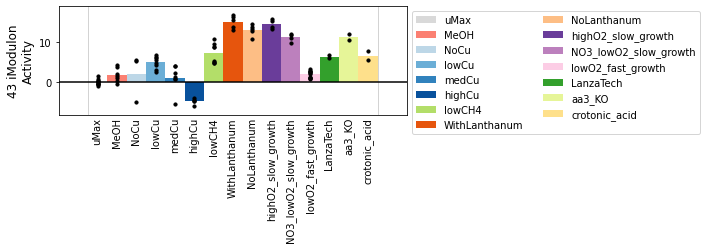

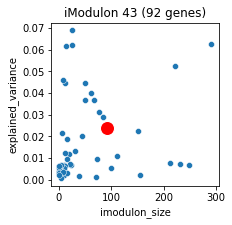

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00190,0.056613,NaN,42656,42884,-1,hypothetical protein,X,No COG annotation,UPI00110D139D,2805,EQU24_RS00195 // EQU24_RS00190,WP_138767047.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00250,-0.068549,NaN,50778,51069,1,hypothetical protein,X,No COG annotation,A0A4P9UIB5,2796,EQU24_RS00250,WP_017841431.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS00525,-0.040331,NaN,108456,108533,1,NaN,X,No COG annotation,NaN,2760,EQU24_RS00525 // rpoD,NaN,||,NaN,[]
EQU24_RS01135,0.051399,NaN,231558,231840,1,hypothetical protein,X,No COG annotation,A0A4P9ULJ3,2673,EQU24_RS01140 // EQU24_RS01135 // EQU24_RS0113...,WP_017841271.1,||None,NaN,[]
EQU24_RS01150,-0.058193,NaN,234038,234461,1,hypothetical protein,X,No COG annotation,A0A4P9UIU6,2671,EQU24_RS01150,WP_017841268.1,||None,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS20590,-0.046333,NaN,4641915,4642194,-1,hypothetical protein,X,No COG annotation,A0A4P9US62,216,EQU24_RS20590,WP_014150183.1,||None,NaN,[]
EQU24_RS20770,-0.041359,NaN,4678204,4678414,-1,hypothetical protein,X,No COG annotation,NaN,190,EQU24_RS20775 // EQU24_RS20770,WP_017841721.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS20950,0.142494,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]
EQU24_RS21260,-0.055496,NaN,4791094,4791280,1,hypothetical protein,X,No COG annotation,NaN,120,EQU24_RS21260,NaN,||,NaN,[]


In [122]:
imod_info(43)

In [123]:
ica_data.imodulon_table.loc[43,'function'] = 'transposase_EW'

## iMod 44

iModulon SG_7


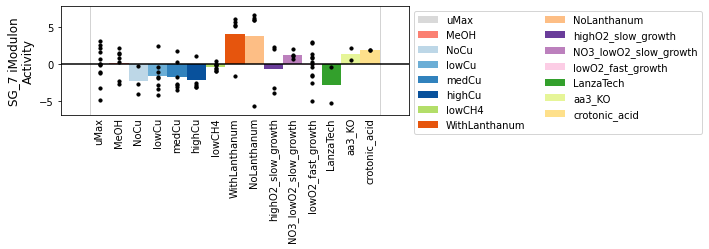

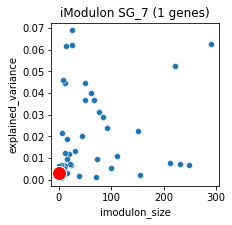

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS01305,0.559227,NaN,265994,267545,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2653,EQU24_RS01305,WP_244310896.1,||None,NaN,[]


In [125]:
imod_info("SG_7")

In [126]:
ica_data.imodulon_table.loc["SG_7",'function'] = 'transposase_EW'

## iMod 45

iModulon 45


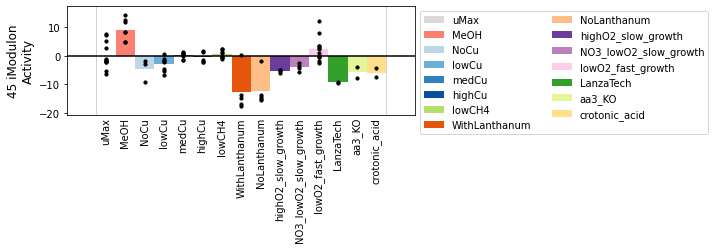

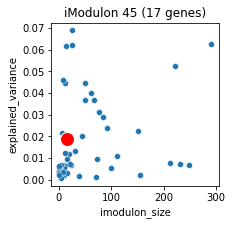

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00780,0.087065,NaN,161810,161999,1,hypothetical protein,X,No COG annotation,NaN,2724,EQU24_RS00780,NaN,||,integral component of membrane\nmembrane,['integral component of membrane' 'membrane']
EQU24_RS02780,0.136971,NaN,598789,598877,-1,NaN,X,No COG annotation,NaN,2450,EQU24_RS02780,NaN,||,NaN,[]
EQU24_RS02970,0.135469,pqqA,634777,634852,-1,pyrroloquinoline quinone precursor peptide PqqA,X,No COG annotation,UPI000223C236,2429,pqqA,WP_006892363.1,pqqA||pqqA,pyrroloquinoline quinone biosynthetic process,['pyrroloquinoline quinone biosynthetic process']
EQU24_RS04160,0.220901,NaN,874502,874683,-1,NaN,X,No COG annotation,NaN,2308,EQU24_RS04170 // EQU24_RS04165 // ssrS // EQU2...,NaN,||,NaN,[]
EQU24_RS05640,0.082970,NaN,1220826,1220902,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]
EQU24_RS05645,0.153492,NaN,1220955,1221031,1,NaN,X,No COG annotation,NaN,2123,EQU24_RS05645 // EQU24_RS05640 // EQU24_RS05635,NaN,||,NaN,[]
EQU24_RS07965,0.161390,NaN,1758864,1758940,1,NaN,X,No COG annotation,NaN,1830,EQU24_RS07965 // EQU24_RS07960 // EQU24_RS0795...,NaN,||,NaN,[]
EQU24_RS09235,0.101818,NaN,2044551,2044648,1,NaN,X,No COG annotation,NaN,1662,ffs,NaN,||,NaN,[]
EQU24_RS09830,0.078386,NaN,2185247,2185322,1,NaN,X,No COG annotation,NaN,1582,EQU24_RS09835 // EQU24_RS09830 // EQU24_RS09825,NaN,||,NaN,[]
EQU24_RS09835,0.116223,NaN,2185369,2185443,1,NaN,X,No COG annotation,NaN,1582,EQU24_RS09835 // EQU24_RS09830 // EQU24_RS09825,NaN,||,NaN,[]


In [127]:
imod_info(45)

In [128]:
ica_data.imodulon_table.loc[45,'function'] = 'pqqa-unclear?_EW'

## iMod 46

iModulon 46


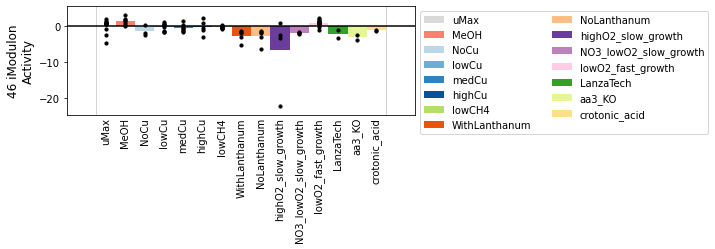

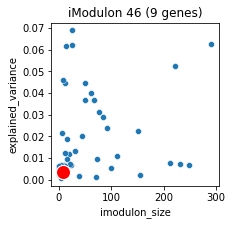

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS01150,0.276803,NaN,234038,234461,1,hypothetical protein,X,No COG annotation,A0A4P9UIU6,2671,EQU24_RS01150,WP_017841268.1,||None,NaN,[]
EQU24_RS01175,0.120823,umuD,237101,237485,-1,translesion error-prone DNA polymerase V autop...,K,Transcription,UPI00191C1247,2668,umuD // EQU24_RS01170,WP_201764864.1,umuD||umuD,"regulation of transcription, DNA-templated\nDN...","['regulation of transcription, DNA-templated' ..."
EQU24_RS01555,-0.169976,NaN,328948,329197,1,hypothetical protein,X,No COG annotation,NaN,2616,EQU24_RS01555,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS02995,0.130412,NaN,638646,638847,-1,hypothetical protein,X,No COG annotation,A0A4P9UJG7,2424,EQU24_RS02995,WP_017840923.1,||None,NaN,[]
EQU24_RS03455,0.253932,NaN,734828,735008,-1,hypothetical protein,X,No COG annotation,NaN,2375,EQU24_RS03455,NaN,||,NaN,[]
EQU24_RS06205,0.274035,NaN,1352804,1353026,-1,hypothetical protein,X,No COG annotation,NaN,2050,EQU24_RS06205,NaN,||,phosphorelay signal transduction system\ninteg...,['phosphorelay signal transduction system'\n '...
EQU24_RS10680,0.231463,NaN,2374756,2375617,-1,IS4 family transposase,L,"Replication, recombination and repair",UPI0015862106,1488,EQU24_RS10685 // EQU24_RS10680,WP_175421679.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS19655,-0.220265,NaN,4416746,4418297,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,336,EQU24_RS19655,WP_040575330.1,||None,NaN,[]
EQU24_RS20770,0.122951,NaN,4678204,4678414,-1,hypothetical protein,X,No COG annotation,NaN,190,EQU24_RS20775 // EQU24_RS20770,WP_017841721.1,||None,integral component of membrane,['integral component of membrane']


In [129]:
imod_info(46)

In [130]:
ica_data.imodulon_table.loc[46,'function'] = 'small-unclear/outlier-response-highO2_slow_FM69_t3_TR1_UW_EW'

## iMod 47

iModulon SG_8


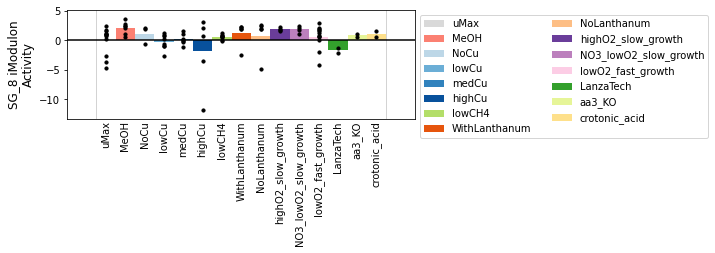

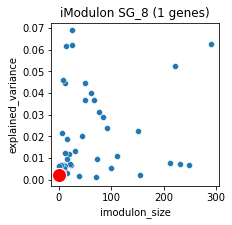

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00175,0.511797,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...


In [132]:
imod_info('SG_8')

In [133]:
ica_data.imodulon_table.loc["SG_8",'function'] = 'hypothetical-prot_EW'

## iMod 48


iModulon 48


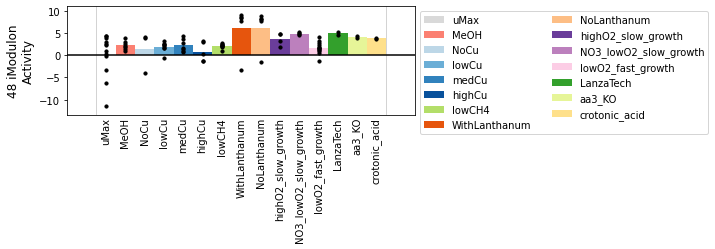

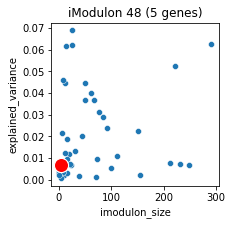

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS01215,0.218936,NaN,244910,246461,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2664,EQU24_RS01215,WP_040575330.1,||None,NaN,[]
EQU24_RS14755,0.400336,NaN,3300040,3300526,-1,hemerythrin domain-containing protein,S,Function unknown,A0A4P9UPL3,966,EQU24_RS14755,WP_017838763.1,||None,NaN,[]
EQU24_RS14930,0.389236,NaN,3328929,3329181,-1,hypothetical protein,X,No COG annotation,NaN,947,EQU24_RS14930,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS20905,0.182978,NaN,4709465,4710749,1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,166,EQU24_RS20905,WP_017841684.1,||None,NaN,[]
EQU24_RS20950,0.167260,NaN,4717305,4718589,-1,ISKra4 family transposase,L,"Replication, recombination and repair",A0A4V1IKC4,161,EQU24_RS20950,WP_017841684.1,||None,NaN,[]


In [134]:
imod_info(48)

In [135]:
ica_data.imodulon_table.loc[48,'function'] = 'transposase_EW'

## iMod 49

iModulon 49


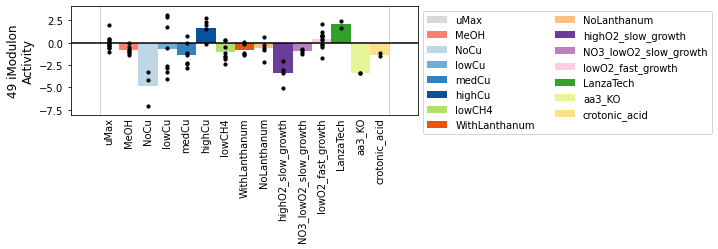

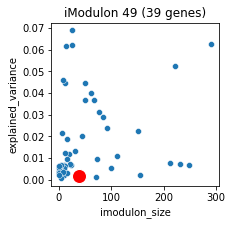

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
48,49,NaN,0.000249,0.056128,0.051282,0.666667,0.095238,2.0,3.0,39.0,KEGG modules,M00153,NaN,Cytochrome bd ubiquinol oxidase
49,49,NaN,0.000495,0.056128,0.051282,0.500000,0.093023,2.0,4.0,39.0,KEGG modules,M00528,NaN,"Nitrification, ammonia => nitrite"
50,49,NaN,0.000495,0.056128,0.051282,0.500000,0.093023,2.0,4.0,39.0,KEGG modules,M00804,NaN,"Complete nitrification, comammox, ammonia => n..."


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00205,-0.208690,NaN,44526,46077,-1,IS66 family transposase,L,"Replication, recombination and repair",NaN,2803,EQU24_RS00205,WP_244310896.1,||None,NaN,[]
EQU24_RS00670,-0.165998,NaN,139733,140330,1,hypothetical protein,X,No COG annotation,A0A4P9ULC6,2740,EQU24_RS00670,WP_017841358.1,||None,NaN,[]
EQU24_RS00675,-0.105439,NaN,140348,142232,-1,c-type cytochrome,C,Energy production and conversion,A0A4P9UIG7,2739,EQU24_RS00675,WP_017841357.1,||None,heme binding\nsignal sequence binding\nelectro...,['heme binding' 'signal sequence binding' 'ele...
EQU24_RS01555,0.104908,NaN,328948,329197,1,hypothetical protein,X,No COG annotation,NaN,2616,EQU24_RS01555,NaN,||,integral component of membrane,['integral component of membrane']
EQU24_RS01570,0.062718,NaN,331924,332122,1,hypothetical protein,X,No COG annotation,NaN,2613,EQU24_RS01570,NaN,||,NaN,[]
EQU24_RS02320,-0.059684,NaN,494906,495476,1,DUF2452 domain-containing protein,S,Function unknown,A0A4V1IJF4,2516,EQU24_RS02320 // EQU24_RS02315 // EQU24_RS0231...,WP_014146873.1,||None,NaN,[]
EQU24_RS02325,-0.093485,NaN,495663,496377,-1,hypothetical protein,X,No COG annotation,A0A4P9UNX9,2515,EQU24_RS02325,WP_017841045.1,||None,NaN,[]
EQU24_RS02345,-0.094140,NaN,503066,503249,-1,hypothetical protein,X,No COG annotation,NaN,2511,EQU24_RS02345,NaN,||,NaN,[]
EQU24_RS04225,-0.077439,NaN,886915,888157,-1,hypothetical protein,X,No COG annotation,UPI001AD8D4FF,2302,EQU24_RS04225,WP_209005076.1,||None,NaN,[]
EQU24_RS05315,-0.069398,cobC,1131367,1131931,-1,alpha-ribazole phosphatase,G,Carbohydrate transport and metabolism,A0A4P9UKH0,2166,cobS // cobC // EQU24_RS05310 // EQU24_RS05305,WP_017840487.1,cobC||cobC,cobalamin biosynthetic process\nalpha-ribazole...,['cobalamin biosynthetic process' 'alpha-ribaz...


In [136]:
imod_info(49)

In [137]:
ica_data.imodulon_table.loc[49,'function'] = 'pmoAB/low-in-NoCU/some-transposase/some-membrane_EW'

## iMod 50

iModulon SG_9


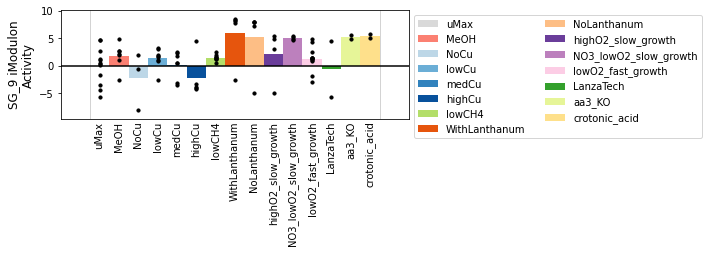

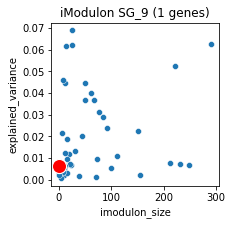

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS11915,0.593938,NaN,2664641,2665580,1,IS66 family transposase,L,"Replication, recombination and repair",NaN,1329,EQU24_RS11915,NaN,||,NaN,[]


In [139]:
imod_info('SG_9')

In [140]:
ica_data.imodulon_table.loc['SG_9','function'] = 'transposase_EW'

## iMod 51

iModulon 51


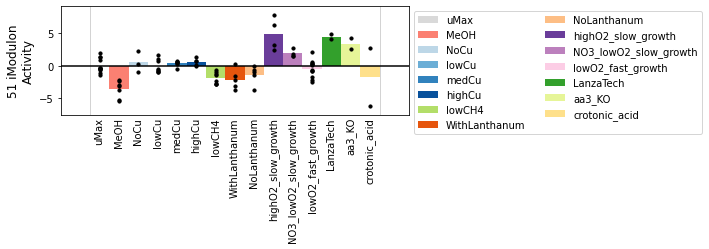

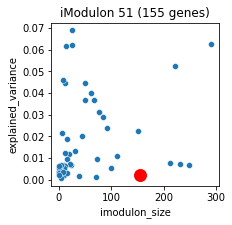

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name
51,51,NaN,0.000024,0.008301,0.032258,0.454545,0.060241,5.0,11.0,155.0,KEGG modules,M00323,NaN,NaN


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00145,0.039882,NaN,34142,34445,-1,hypothetical protein,J,"Translation, ribosomal structure and biogenesis",A0A4P9UL47,2812,EQU24_RS00155 // EQU24_RS00150 // EQU24_RS00145,WP_014146553.1,||None,response to osmotic stress\nresponse to abioti...,['response to osmotic stress' 'response to abi...
EQU24_RS00155,0.040967,NaN,36035,36347,-1,hypothetical protein,X,No COG annotation,A0A4P9UKJ0,2812,EQU24_RS00155 // EQU24_RS00150 // EQU24_RS00145,WP_017841446.1,||None,NaN,[]
EQU24_RS00175,0.086448,NaN,39992,40271,-1,hypothetical protein,L,"Replication, recombination and repair",A0A4P9UIR2,2808,EQU24_RS00175,WP_017841442.1,||None,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS00240,-0.037402,NaN,49350,49572,1,hypothetical protein,X,No COG annotation,NaN,2798,EQU24_RS00240,NaN,||,NaN,[]
EQU24_RS00295,0.036869,NaN,62264,62591,-1,hypothetical protein,X,No COG annotation,NaN,2788,EQU24_RS00295,NaN,||,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS21810,-0.042377,NaN,4919808,4920090,1,XRE family transcriptional regulator,K,Transcription,A0A4P9USY3,44,EQU24_RS21810 // EQU24_RS21805,WP_017841540.1,||None,DNA binding,['DNA binding']
EQU24_RS21890,0.040682,NaN,4939707,4939902,-1,hypothetical protein,X,No COG annotation,A0A4P9USR3,35,EQU24_RS21890,WP_017841524.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS21900,0.040796,NaN,4941039,4941474,-1,biopolymer transporter ExbD,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UST2,34,EQU24_RS21900 // EQU24_RS21895,WP_040575763.1,||None,protein transport\nplasma membrane\nintegral c...,['protein transport' 'plasma membrane' 'integr...
EQU24_RS21905,0.037863,NaN,4941641,4942169,-1,MotA/TolQ/ExbB proton channel family protein,U,"Intracellular trafficking, secretion, and vesi...",A0A4V1IKE2,33,EQU24_RS21915 // EQU24_RS21910 // EQU24_RS21905,WP_017841521.1,||None,protein transport\nintegral component of membrane,['protein transport' 'integral component of me...


In [141]:
imod_info(51)

In [142]:
ica_data.imodulon_table.loc[51,'function'] = 'some-transposase/some-membrane/up-in-highO2_slow_growth_EW'

## iMod 52

iModulon 52


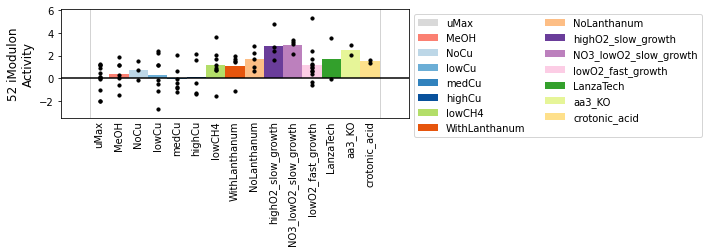

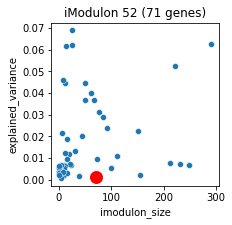

,imodulon,go_name,pvalue,qvalue,precision,recall,f1score,TP,target_set_size,imodulon_size,source,annotation,pathway_name,module_name


,gene_weight,gene_symbol,start_coord,end_coord,strand,product,COG,cog_name,uniprot,tu_id,tu_name,ncbi_protein,gene_name_extra,specific_gos_n,specific_gos
EQU24_RS00075,-0.046125,tatB,19487,19799,1,twin-arginine translocase subunit TatB,U,"Intracellular trafficking, secretion, and vesi...",A0A4P9UII1,2822,tatB // tatA,WP_017841462.1,tatB||tatB,peptide transport\namide transport\norganic su...,['peptide transport' 'amide transport' 'organi...
EQU24_RS00250,-0.083779,NaN,50778,51069,1,hypothetical protein,X,No COG annotation,A0A4P9UIB5,2796,EQU24_RS00250,WP_017841431.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS01030,-0.045907,NaN,214040,214394,-1,hypothetical protein,X,No COG annotation,A0A4P9UNE4,2687,EQU24_RS01030,WP_017841293.1,||None,NaN,[]
EQU24_RS01055,0.059053,NaN,217427,217802,1,Tn3 family transposase,L,"Replication, recombination and repair",UPI0003469BE6,2683,EQU24_RS01055 // EQU24_RS01050,WP_017841280.1,||None,"transposase activity\ntransposition, DNA-mediated","['transposase activity' 'transposition, DNA-me..."
EQU24_RS01155,-0.064257,NaN,234648,234873,1,hypothetical protein,X,No COG annotation,UPI0009FE04B7,2670,EQU24_RS01155,WP_083877732.1,||None,NaN,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EQU24_RS20595,-0.057779,NaN,4643142,4644009,1,hypothetical protein,G,Carbohydrate transport and metabolism,UPI00110CC19A,215,EQU24_RS20595,WP_138767249.1,||None,protein binding,['protein binding']
EQU24_RS20610,0.197353,NaN,4646544,4647282,-1,ISAs1 family transposase,L,"Replication, recombination and repair",NaN,212,EQU24_RS20615 // EQU24_RS20610,NaN,||,DNA binding\ntransposase activity\ntranspositi...,['DNA binding' 'transposase activity' 'transpo...
EQU24_RS20765,0.052683,NaN,4677500,4678028,-1,phosphatase PAP2 family protein,I,Lipid transport and metabolism,A0A4P9US91,191,EQU24_RS20765 // EQU24_RS20760,WP_017841722.1,||None,integral component of membrane,['integral component of membrane']
EQU24_RS20900,0.053318,NaN,4708570,4708813,-1,hypothetical protein,X,No COG annotation,A0A4P9USB7,167,EQU24_RS20900 // EQU24_RS20895,WP_017841694.1,||None,NaN,[]


In [143]:
imod_info(52)

In [144]:
ica_data.imodulon_table.loc[52,'function'] = 'some-transposase/some-membrane/some-iron-sulfur/up-in-slow_growth_EW'

## Manually curate functions

In [147]:
ica_data.imodulon_table.function.value_counts()

transposase_EW                                                          6
hypothetical-prot_EW                                                    3
unclear_EW                                                              2
translation/ribosomal/biosynthesis_EW                                   2
large-unclear_EW                                                        2
TonB-receptor/up-in-both-La-vials_EW                                    1
small-unclear_EW                                                        1
ion-transport/outlier-repsonse-FM11_EW                                  1
sulfate-transport/messy-threshold_EW                                    1
unclear/outlier-response-wLa-vial_EW                                    1
transposase/toxin-anti-toxin_EW                                         1
nif/electron-transport_EW                                               1
SG-hypothetical_EW                                                      1
some-membrane/outlier-response-highCu_

# Save final ICA data object

In [148]:
data_dir

'../data/5g_processed_data'

In [154]:
save_to_json(ica_data, path.join(data_dir, '5g_curated.json.gz'))

In [155]:
ica_data.imodulon_table.to_csv(path.join(data_dir, '5g_imodulon_table.csv'))

In [153]:
ica_data.imodulon_table

,single_gene,imodulon_size,explained_variance,category,function
0,,111,0.010961,uncharacterized,unclear_EW
1,,23,0.006986,uncharacterized,unclear_EW
2,,44,0.020010,functional,iron-sulfur-binding-and-transport?_EW
SG_1,True,1,0.003638,single_gene,cas2_EW
4,,3,0.004384,uncharacterized,small_unclear_EW
5,,62,0.040222,uncharacterized,FM20_TR1_QC-outlier-response_EW
6,,20,0.011649,uncharacterized,transposase/FM03_TR1_QC-outlier-response_EW
7,,5,0.004450,uncharacterized,TonB-receptor/up-in-both-La-vials_EW
8,,6,0.021518,functional,mxa-gene-cluster_EW
9,,16,0.009330,functional,groEL/ES-post-translation-mod_EW
